# Denoising Diffusion Implicit Models

**Author:** [András Béres](https://www.linkedin.com/in/andras-beres-789190210)<br>
**Date created:** 2022/06/24<br>
**Last modified:** 2022/06/24<br>
**Description:** Generating images of flowers with denoising diffusion implicit models.

## Introduction

### What are diffusion models?

Recently, [denoising diffusion models](https://arxiv.org/abs/2006.11239), including
[score-based generative models](https://arxiv.org/abs/1907.05600), gained popularity as a
powerful class of generative models, that can [rival](https://arxiv.org/abs/2105.05233)
even [generative adversarial networks (GANs)](https://arxiv.org/abs/1406.2661) in image
synthesis quality. They tend to generate more diverse samples, while being stable to
train and easy to scale. Recent large diffusion models, such as
[DALL-E 2](https://openai.com/dall-e-2/) and [Imagen](https://imagen.research.google/),
have shown incredible text-to-image generation capability. One of their drawbacks is
however, that they are slower to sample from, because they require multiple forward passes
for generating an image.

Diffusion refers to the process of turning a structured signal (an image) into noise
step-by-step. By simulating diffusion, we can generate noisy images from our training
images, and can train a neural network to try to denoise them. Using the trained network
we can simulate the opposite of diffusion, reverse diffusion, which is the process of an
image emerging from noise.

![diffusion process gif](https://i.imgur.com/dipPOfa.gif)

One-sentence summary: **diffusion models are trained to denoise noisy images, and can
generate images by iteratively denoising pure noise.**

### Goal of this example

This code example intends to be a minimal but feature-complete (with a generation quality
metric) implementation of diffusion models, with modest compute requirements and
reasonable performance. My implementation choices and hyperparameter tuning were done
with these goals in mind.

Since currently the literature of diffusion models is
[mathematically quite complex](https://arxiv.org/abs/2206.00364)
with multiple theoretical frameworks
([score matching](https://arxiv.org/abs/1907.05600),
[differential equations](https://arxiv.org/abs/2011.13456),
[Markov chains](https://arxiv.org/abs/2006.11239)) and sometimes even
[conflicting notations (see Appendix C.2)](https://arxiv.org/abs/2010.02502),
it can be daunting trying to understand
them. My view of these models in this example will be that they learn to separate a
noisy image into its image and Gaussian noise components.

In this example I made effort to break down all long mathematical expressions into
digestible pieces and gave all variables explanatory names. I also included numerous
links to relevant literature to help interested readers dive deeper into the topic, in
the hope that this code example will become a good starting point for practitioners
learning about diffusion models.

In the following sections, we will implement a continuous time version of
[Denoising Diffusion Implicit Models (DDIMs)](https://arxiv.org/abs/2010.02502)
with deterministic sampling.

## Setup

In [1]:
import os

os.environ["KERAS_BACKEND"] = "tensorflow"

import math
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_datasets as tfds

import keras
from keras import layers
from keras import ops

2024-05-27 18:21:13.400545: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-05-27 18:21:13.462135: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-05-27 18:21:14.369750: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/home/ashish/.local/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_t

In [2]:
# Some Optimizations
import ctypes

_libcudart = ctypes.CDLL("libcudart.so")
# Set device limit on the current device
# cudaLimitMaxL2FetchGranularity = 0x05
pValue = ctypes.cast((ctypes.c_int * 1)(), ctypes.POINTER(ctypes.c_int))
_libcudart.cudaDeviceSetLimit(ctypes.c_int(0x05), ctypes.c_int(128))
_libcudart.cudaDeviceGetLimit(pValue, ctypes.c_int(0x05))
assert pValue.contents.value == 128
tf.compat.v1.ConfigProto.force_gpu_compatible = True

keras.config.set_image_data_format("channels_last")

gpus = tf.config.list_physical_devices("GPU")
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.list_logical_devices("GPU")
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

1 Physical GPUs, 1 Logical GPUs


2024-05-27 18:21:16.533319: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1928] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 38364 MB memory:  -> device: 0, name: NVIDIA A100-SXM4-40GB, pci bus id: 0000:00:04.0, compute capability: 8.0


## Hyperparameters

In [3]:
# data
dataset_name = "oxford_flowers102"
dataset_repetitions = 5
num_epochs = 1  # train for at least 50 epochs for good results
image_size = 64
# KID = Kernel Inception Distance, see related section
kid_image_size = 75
kid_diffusion_steps = 5
plot_diffusion_steps = 20

# sampling
min_signal_rate = 0.02
max_signal_rate = 0.95

# architecture
embedding_dims = 32
embedding_max_frequency = 1000.0
widths = [32, 64, 96, 128]
block_depth = 2

# optimization
batch_size = 64
ema = 0.999
learning_rate = 1e-3
weight_decay = 1e-4

In [4]:
# precision_policy = keras.mixed_precision.Policy('mixed_float16')
precision_policy = keras.mixed_precision.Policy("float32")
keras.mixed_precision.set_global_policy(precision_policy)
tf.keras.mixed_precision.set_global_policy(precision_policy)

In [5]:
normalizeImage = lambda x: tf.divide(
    tf.subtract(tf.cast(x, dtype=precision_policy.compute_dtype), 127.5), 127.5
)
denormalizeImage = lambda x: tf.cast(
    tf.add(tf.multiply(x, 127.5), 127.5), dtype=tf.uint8
)

l2normalizeImage = lambda x: tf.math.l2_normalize(x)


def plotImages(imgs, fig_size=(8, 8), dpi=100):
    fig = plt.figure(figsize=fig_size, dpi=dpi)
    imglen = imgs.shape[0]
    for i in range(imglen):
        plt.subplot(fig_size[0], fig_size[1], i + 1)
        plt.imshow(tf.cast(denormalizeImage(imgs[i, :, :, :]), tf.uint8))
        plt.axis("off")
    plt.show()

## Data pipeline

We will use the
[Oxford Flowers 102](https://www.tensorflow.org/datasets/catalog/oxford_flowers102)
dataset for
generating images of flowers, which is a diverse natural dataset containing around 8,000
images. Unfortunately the official splits are imbalanced, as most of the images are
contained in the test split. We create new splits (80% train, 20% validation) using the
[Tensorflow Datasets slicing API](https://www.tensorflow.org/datasets/splits). We apply
center crops as preprocessing, and repeat the dataset multiple times (reason given in the
next section).

In [6]:
def get_dataset(data_name="celeb_a", batch_size=64, image_scale=256):
    def augmenter(image_scale=256, method="area"):
        @tf.function()
        def augment(sample):
            image = (
                tf.cast(sample["image"], precision_policy.compute_dtype) - 127.5
            ) / 127.5
            image = tf.image.resize(
                image, [image_scale, image_scale], method=method, antialias=True
            )
            image = tf.image.random_flip_left_right(image)
            return image

        return augment

    # Load CelebA Dataset
    data: tf.data.Dataset = tfds.load(data_name, split="all", shuffle_files=True)
    final_data = (
        data
        # .prefetch(tf.data.experimental.AUTOTUNE)
        # .batch(128, num_parallel_calls=tf.data.AUTOTUNE)
        .map(
            augmenter(image_scale, method="area"),
            num_parallel_calls=tf.data.AUTOTUNE,
        )
        .cache()  # Cache after augmenting to avoid recomputation
        .repeat()  # Repeats the dataset indefinitely
        # .unbatch()
        .shuffle(4096)  # Ensure this is adequate for your dataset size
        .batch(batch_size, drop_remainder=True)
        .prefetch(tf.data.experimental.AUTOTUNE)
    )
    return final_data, len(data)

## Kernel inception distance

[Kernel Inception Distance (KID)](https://arxiv.org/abs/1801.01401) is an image quality
metric which was proposed as a replacement for the popular
[Frechet Inception Distance (FID)](https://arxiv.org/abs/1706.08500).
I prefer KID to FID because it is simpler to
implement, can be estimated per-batch, and is computationally lighter. More details
[here](https://keras.io/examples/generative/gan_ada/#kernel-inception-distance).

In this example, the images are evaluated at the minimal possible resolution of the
Inception network (75x75 instead of 299x299), and the metric is only measured on the
validation set for computational efficiency. We also limit the number of sampling steps
at evaluation to 5 for the same reason.

Since the dataset is relatively small, we go over the train and validation splits
multiple times per epoch, because the KID estimation is noisy and compute-intensive, so
we want to evaluate only after many iterations, but for many iterations.

In [7]:

@keras.saving.register_keras_serializable()
class KID(keras.metrics.Metric):
    def __init__(self, name, **kwargs):
        super().__init__(name=name, **kwargs)

        # KID is estimated per batch and is averaged across batches
        self.kid_tracker = keras.metrics.Mean(name="kid_tracker")

        # a pretrained InceptionV3 is used without its classification layer
        # transform the pixel values to the 0-255 range, then use the same
        # preprocessing as during pretraining
        self.encoder = keras.Sequential(
            [
                keras.Input(shape=(image_size, image_size, 3)),
                layers.Rescaling(255.0),
                layers.Resizing(height=kid_image_size, width=kid_image_size),
                layers.Lambda(keras.applications.inception_v3.preprocess_input),
                keras.applications.InceptionV3(
                    include_top=False,
                    input_shape=(kid_image_size, kid_image_size, 3),
                    weights="imagenet",
                ),
                layers.GlobalAveragePooling2D(),
            ],
            name="inception_encoder",
        )

    def polynomial_kernel(self, features_1, features_2):
        feature_dimensions = ops.cast(ops.shape(features_1)[1], dtype="float32")
        return (
            features_1 @ ops.transpose(features_2) / feature_dimensions + 1.0
        ) ** 3.0

    def update_state(self, real_images, generated_images, sample_weight=None):
        real_features = self.encoder(real_images, training=False)
        generated_features = self.encoder(generated_images, training=False)

        # compute polynomial kernels using the two sets of features
        kernel_real = self.polynomial_kernel(real_features, real_features)
        kernel_generated = self.polynomial_kernel(
            generated_features, generated_features
        )
        kernel_cross = self.polynomial_kernel(real_features, generated_features)

        # estimate the squared maximum mean discrepancy using the average kernel values
        batch_size = real_features.shape[0]
        batch_size_f = ops.cast(batch_size, dtype="float32")
        mean_kernel_real = ops.sum(kernel_real * (1.0 - ops.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_generated = ops.sum(
            kernel_generated * (1.0 - ops.eye(batch_size))
        ) / (batch_size_f * (batch_size_f - 1.0))
        mean_kernel_cross = ops.mean(kernel_cross)
        kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

        # update the average KID estimate
        self.kid_tracker.update_state(kid)

    def result(self):
        return self.kid_tracker.result()

    def reset_state(self):
        self.kid_tracker.reset_state()


## Network architecture

Here we specify the architecture of the neural network that we will use for denoising. We
build a [U-Net](https://arxiv.org/abs/1505.04597) with identical input and output
dimensions. U-Net is a popular semantic segmentation architecture, whose main idea is
that it progressively downsamples and then upsamples its input image, and adds skip
connections between layers having the same resolution. These help with gradient flow and
avoid introducing a representation bottleneck, unlike usual
[autoencoders](https://www.deeplearningbook.org/contents/autoencoders.html). Based on
this, one can view
[diffusion models as denoising autoencoders](https://benanne.github.io/2022/01/31/diffusion.html)
without a bottleneck.

The network takes two inputs, the noisy images and the variances of their noise
components. The latter is required since denoising a signal requires different operations
at different levels of noise. We transform the noise variances using sinusoidal
embeddings, similarly to positional encodings used both in
[transformers](https://arxiv.org/abs/1706.03762) and
[NeRF](https://arxiv.org/abs/2003.08934). This helps the network to be
[highly sensitive](https://arxiv.org/abs/2006.10739) to the noise level, which is
crucial for good performance. We implement sinusoidal embeddings using a
[Lambda layer](https://keras.io/api/layers/core_layers/lambda/).

Some other considerations:

* We build the network using the
[Keras Functional API](https://keras.io/guides/functional_api/), and use
[closures](https://twitter.com/fchollet/status/1441927912836321280) to build blocks of
layers in a consistent style.
* [Diffusion models](https://arxiv.org/abs/2006.11239) embed the index of the timestep of
the diffusion process instead of the noise variance, while
[score-based models (Table 1)](https://arxiv.org/abs/2206.00364)
usually use some function of the noise level. I
prefer the latter so that we can change the sampling schedule at inference time, without
retraining the network.
* [Diffusion models](https://arxiv.org/abs/2006.11239) input the embedding to each
convolution block separately. We only input it at the start of the network for
simplicity, which in my experience barely decreases performance, because the skip and
residual connections help the information propagate through the network properly.
* In the literature it is common to use
[attention layers](https://keras.io/api/layers/attention_layers/multi_head_attention/)
at lower resolutions for better global coherence. I omitted it for simplicity.
* We disable the learnable center and scale parameters of the batch normalization layers,
since the following convolution layers make them redundant.
* We initialize the last convolution's kernel to all zeros as a good practice, making the
network predict only zeros after initialization, which is the mean of its targets. This
will improve behaviour at the start of training and make the mean squared error loss
start at exactly 1.

In [8]:

@keras.saving.register_keras_serializable()
def sinusoidal_embedding(x):
    embedding_min_frequency = 1.0
    embedding_max_frequency = 1000.0
    embedding_dims = 32
    frequencies = keras.ops.exp(
        keras.ops.linspace(
            keras.ops.log(embedding_min_frequency),
            keras.ops.log(embedding_max_frequency),
            embedding_dims // 2,
        )
    )
    angular_speeds = keras.ops.cast(2.0 * math.pi * frequencies, "float32")
    embeddings = keras.ops.concatenate(
        [keras.ops.sin(angular_speeds * x), keras.ops.cos(angular_speeds * x)], axis=3
    )
    return embeddings

def ResidualBlock(width):
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        x = layers.Add()([x, residual])
        return x

    return apply


def DownBlock(width, block_depth):
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            skips.append(x)
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply


def get_network(image_size, widths, block_depth):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))

    e = layers.Lambda(sinusoidal_embedding, output_shape=(1, 1, 32))(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e])

    skips = []
    for width in widths[:-1]:
        x = DownBlock(width, block_depth)([x, skips])

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width in reversed(widths[:-1]):
        x = UpBlock(width, block_depth)([x, skips])

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images, noise_variances], x, name="residual_unet")


This showcases the power of the Functional API. Note how we built a relatively complex
U-Net with skip connections, residual blocks, multiple inputs, and sinusoidal embeddings
in 80 lines of code!

## Diffusion model

### Diffusion schedule

Let us say, that a diffusion process starts at time = 0, and ends at time = 1. This
variable will be called diffusion time, and can be either discrete (common in diffusion
models) or continuous (common in score-based models). I choose the latter, so that the
number of sampling steps can be changed at inference time.

We need to have a function that tells us at each point in the diffusion process the noise
levels and signal levels of the noisy image corresponding to the actual diffusion time.
This will be called the diffusion schedule (see `diffusion_schedule()`).

This schedule outputs two quantities: the `noise_rate` and the `signal_rate`
(corresponding to sqrt(1 - alpha) and sqrt(alpha) in the DDIM paper, respectively). We
generate the noisy image by weighting the random noise and the training image by their
corresponding rates and adding them together.

Since the (standard normal) random noises and the (normalized) images both have zero mean
and unit variance, the noise rate and signal rate can be interpreted as the standard
deviation of their components in the noisy image, while the squares of their rates can be
interpreted as their variance (or their power in the signal processing sense). The rates
will always be set so that their squared sum is 1, meaning that the noisy images will
always have unit variance, just like its unscaled components.

We will use a simplified, continuous version of the
[cosine schedule (Section 3.2)](https://arxiv.org/abs/2102.09672),
that is quite commonly used in the literature.
This schedule is symmetric, slow towards the start and end of the diffusion process, and
it also has a nice geometric interpretation, using the
[trigonometric properties of the unit circle](https://en.wikipedia.org/wiki/Unit_circle#/media/File:Circle-trig6.svg):

![diffusion schedule gif](https://i.imgur.com/JW9W0fA.gif)

### Training process

The training procedure (see `train_step()` and `denoise()`) of denoising diffusion models
is the following: we sample random diffusion times uniformly, and mix the training images
with random gaussian noises at rates corresponding to the diffusion times. Then, we train
the model to separate the noisy image to its two components.

Usually, the neural network is trained to predict the unscaled noise component, from
which the predicted image component can be calculated using the signal and noise rates.
Pixelwise
[mean squared error](https://keras.io/api/losses/regression_losses/#mean_squared_error-function) should
be used theoretically, however I recommend using
[mean absolute error](https://keras.io/api/losses/regression_losses/#mean_absolute_error-function)
instead (similarly to
[this](https://github.com/lucidrains/denoising-diffusion-pytorch/blob/master/denoising_diffusion_pytorch/denoising_diffusion_pytorch.py#L371)
implementation), which produces better results on this dataset.

### Sampling (reverse diffusion)

When sampling (see `reverse_diffusion()`), at each step we take the previous estimate of
the noisy image and separate it into image and noise using our network. Then we recombine
these components using the signal and noise rate of the following step.

Though a similar view is shown in
[Equation 12 of DDIMs](https://arxiv.org/abs/2010.02502), I believe the above explanation
of the sampling equation is not widely known.

This example only implements the deterministic sampling procedure from DDIM, which
corresponds to *eta = 0* in the paper. One can also use stochastic sampling (in which
case the model becomes a
[Denoising Diffusion Probabilistic Model (DDPM)](https://arxiv.org/abs/2006.11239)),
where a part of the predicted noise is
replaced with the same or larger amount of random noise
([see Equation 16 and below](https://arxiv.org/abs/2010.02502)).

Stochastic sampling can be used without retraining the network (since both models are
trained the same way), and it can improve sample quality, while on the other hand
requiring more sampling steps usually.

In [16]:

@keras.saving.register_keras_serializable()
class DiffusionModel(keras.Model):
    def __init__(self, image_size, widths, block_depth):
        super().__init__()

        # self.normalizer = layers.Normalization()
        self.network = get_network(image_size, widths, block_depth)
        # self.ema_network = keras.models.clone_model(self.network)

    def compile(self, **kwargs):
        super().compile(**kwargs)

        self.noise_loss_tracker = keras.metrics.Mean(name="n_loss")
        self.image_loss_tracker = keras.metrics.Mean(name="i_loss")
        self.kid = KID(name="kid")

    @property
    def metrics(self):
        return [self.noise_loss_tracker, self.image_loss_tracker, self.kid]

    def denormalize(self, images):
        # convert the pixel values back to 0-1 range
        # images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return ops.clip(images, -1.0, 1.0)

    def diffusion_schedule(self, diffusion_times):
        # diffusion times -> angles
        start_angle = ops.cast(ops.arccos(max_signal_rate), "float32")
        end_angle = ops.cast(ops.arccos(min_signal_rate), "float32")

        diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)

        # angles -> signal and noise rates
        signal_rates = ops.cos(diffusion_angles)
        noise_rates = ops.sin(diffusion_angles)
        # note that their squared sum is always: sin^2(x) + cos^2(x) = 1

        return noise_rates, signal_rates

    def denoise(self, noisy_images, noise_rates, signal_rates, training):
        # the exponential moving average weights are used at evaluation
        network = self.network

        # predict noise component and calculate the image component using it
        pred_noises = network([noisy_images, noise_rates**2], training=training)
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates

        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps):
        # reverse diffusion = sampling
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps

        # important line:
        # at the first sampling step, the "noisy image" is pure noise
        # but its signal rate is assumed to be nonzero (min_signal_rate)
        next_noisy_images = initial_noise
        for step in range(diffusion_steps):
            noisy_images = next_noisy_images

            # separate the current noisy image to its components
            diffusion_times = ops.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=False
            )
            # network used in eval mode

            # remix the predicted components using the next signal and noise rates
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            next_noisy_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )
            # this new noisy image will be used in the next step

        return pred_images

    def generate(self, num_images, diffusion_steps):
        # noise -> images -> denormalized images
        initial_noise = keras.random.normal(
            shape=(num_images, image_size, image_size, 3)
        )
        generated_images = self.reverse_diffusion(initial_noise, diffusion_steps)
        generated_images = self.denormalize(generated_images)
        return generated_images

    def train_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        noises = keras.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = keras.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # train the network to separate noisy images to their components
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # used for training
            image_loss = self.loss(images, pred_images)  # only used as metric

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.network.trainable_weights))

        self.noise_loss_tracker.update_state(noise_loss)
        self.image_loss_tracker.update_state(image_loss)

        # # track the exponential moving averages of weights
        # for weight, ema_weight in zip(self.network.weights, self.ema_network.weights):
        #     ema_weight.assign(ema * ema_weight + (1 - ema) * weight)

        # KID is not measured during the training phase for computational efficiency
        return {m.name: m.result() for m in self.metrics[:-1]}

    def plot_images(self, epoch=None, logs=None, num_rows=3, num_cols=6):
        # plot random generated images for visual evaluation of generation quality
        generated_images = self.generate(
            num_images=num_rows * num_cols,
            diffusion_steps=plot_diffusion_steps,
        )
        plotImages(generated_images)


## Training

In [22]:
# create and compile the model
model = DiffusionModel(image_size, widths, block_depth)
# below tensorflow 2.9:
# pip install tensorflow_addons
# import tensorflow_addons as tfa
# optimizer=tfa.optimizers.AdamW
model.compile(
    optimizer=keras.optimizers.AdamW(
        learning_rate=learning_rate, weight_decay=weight_decay
    ),
    loss=keras.losses.mean_absolute_error,
)
# pixelwise mean absolute error is used as loss

# save the best model based on the validation KID metric
checkpoint_path = "checkpoints/diffusion_model.weights.h5"
checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor="val_kid",
    mode="min",
    save_best_only=True,
)

# calculate mean and variance of training dataset for normalization
# model.normalizer.adapt(train_dataset)


Epoch 1/500


127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - i_loss: 1.2115 - n_loss: 0.4088

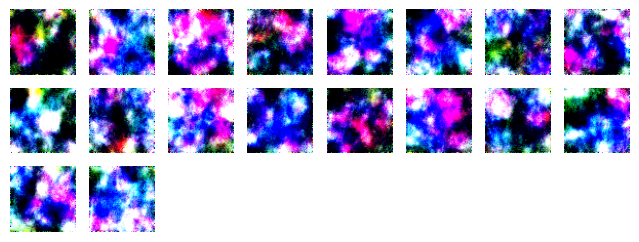

127/127 ━━━━━━━━━━━━━━━━━━━━ 29s 49ms/step - i_loss: 1.2072 - n_loss: 0.4077
Epoch 2/500
  5/127 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - i_loss: 0.3719 - n_loss: 0.1588

/home/ashish/.local/lib/python3.10/site-packages/keras/src/callbacks/model_checkpoint.py:206: UserWarning: Can save best model only with val_kid available, skipping.
  self._save_model(epoch=epoch, batch=None, logs=logs)


127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.3032 - n_loss: 0.1545

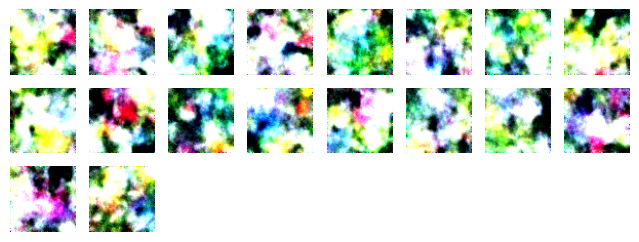

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.3030 - n_loss: 0.1545
Epoch 3/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.2482 - n_loss: 0.1444

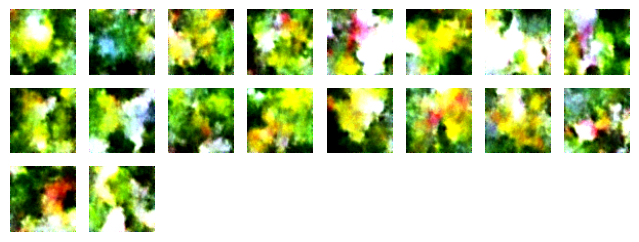

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.2482 - n_loss: 0.1444
Epoch 4/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.2255 - n_loss: 0.1399

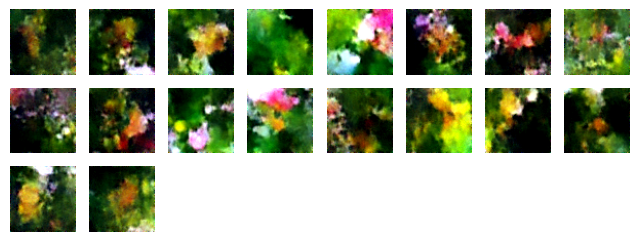

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.2255 - n_loss: 0.1399
Epoch 5/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.2188 - n_loss: 0.1345

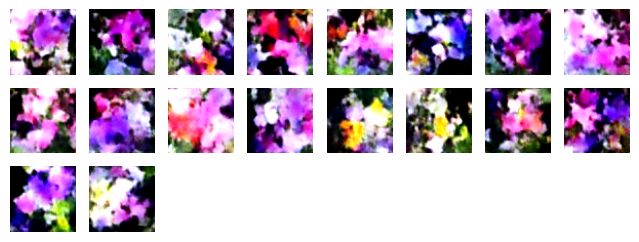

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.2188 - n_loss: 0.1345
Epoch 6/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.2142 - n_loss: 0.1312

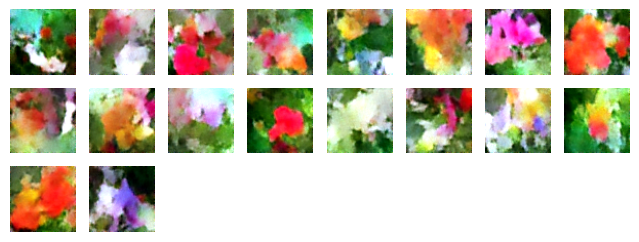

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.2142 - n_loss: 0.1311
Epoch 7/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.2065 - n_loss: 0.1280

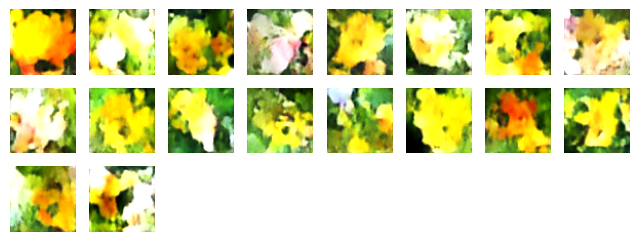

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.2065 - n_loss: 0.1280
Epoch 8/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - i_loss: 0.2041 - n_loss: 0.1277

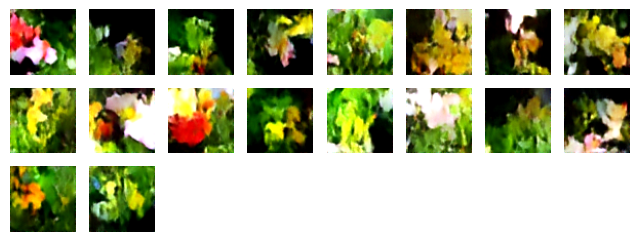

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 55ms/step - i_loss: 0.2042 - n_loss: 0.1277
Epoch 9/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1966 - n_loss: 0.1265

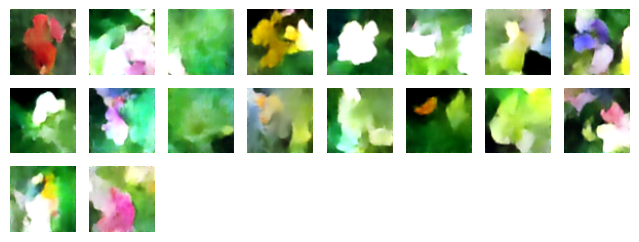

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1966 - n_loss: 0.1265
Epoch 10/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.2021 - n_loss: 0.1262

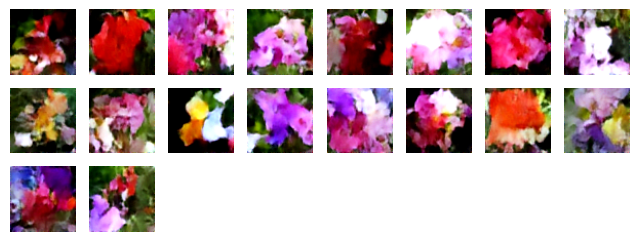

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.2020 - n_loss: 0.1262
Epoch 11/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1985 - n_loss: 0.1253

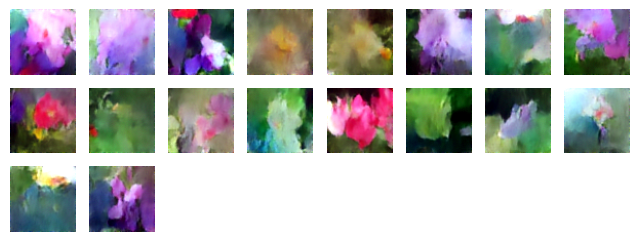

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1985 - n_loss: 0.1253
Epoch 12/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1967 - n_loss: 0.1233

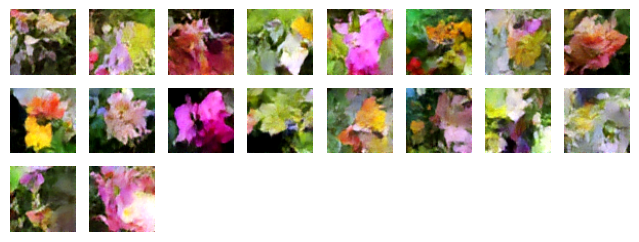

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1966 - n_loss: 0.1233
Epoch 13/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1915 - n_loss: 0.1222

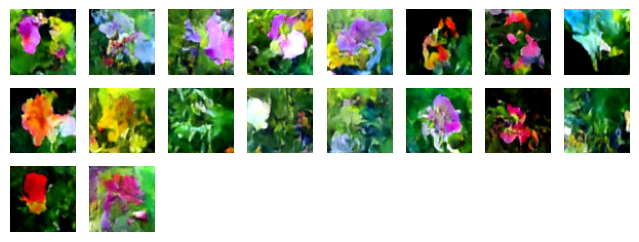

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1915 - n_loss: 0.1222
Epoch 14/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1970 - n_loss: 0.1226

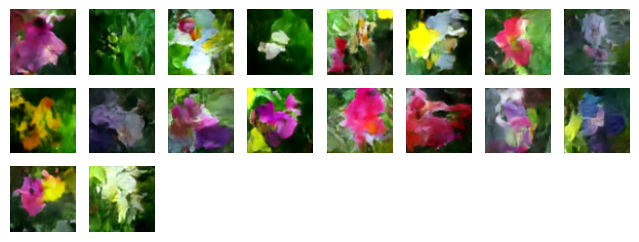

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1970 - n_loss: 0.1226
Epoch 15/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1899 - n_loss: 0.1223

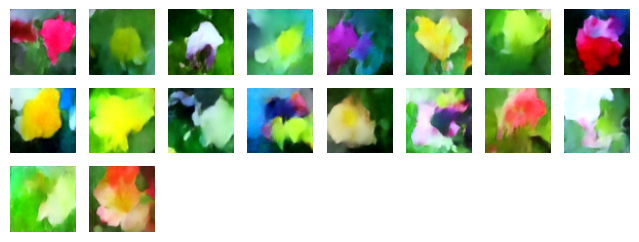

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1899 - n_loss: 0.1223
Epoch 16/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1926 - n_loss: 0.1213

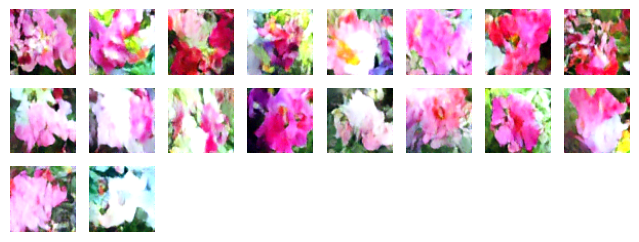

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1926 - n_loss: 0.1213
Epoch 17/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1921 - n_loss: 0.1222

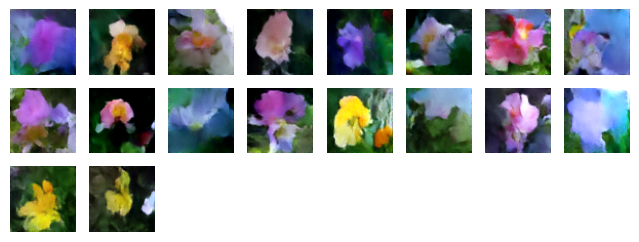

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - i_loss: 0.1921 - n_loss: 0.1222
Epoch 18/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1878 - n_loss: 0.1202

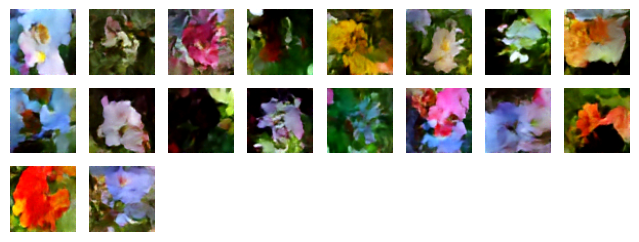

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1878 - n_loss: 0.1202
Epoch 19/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1867 - n_loss: 0.1207

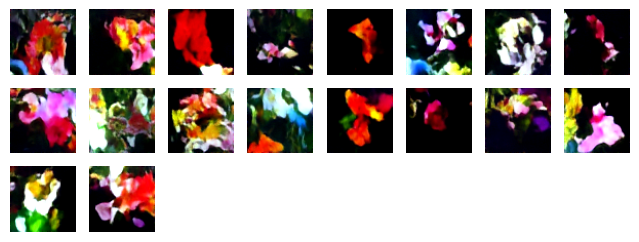

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1867 - n_loss: 0.1207
Epoch 20/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1890 - n_loss: 0.1210

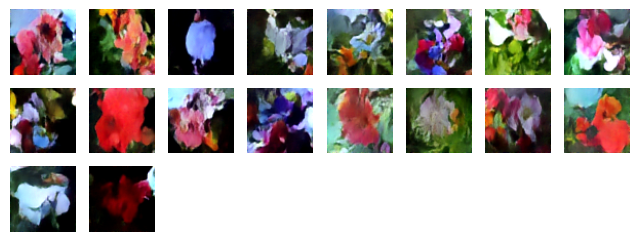

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1890 - n_loss: 0.1210
Epoch 21/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1876 - n_loss: 0.1181

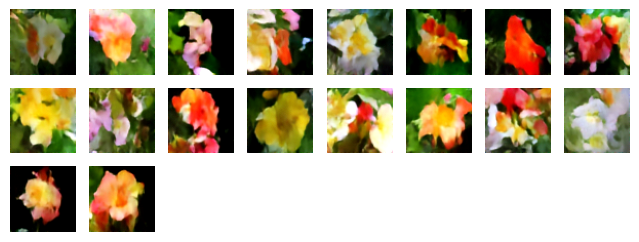

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1876 - n_loss: 0.1181
Epoch 22/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1834 - n_loss: 0.1194

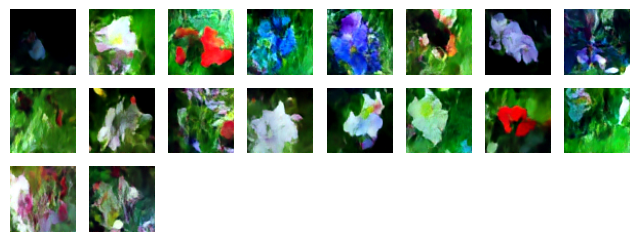

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1834 - n_loss: 0.1194
Epoch 23/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1817 - n_loss: 0.1191

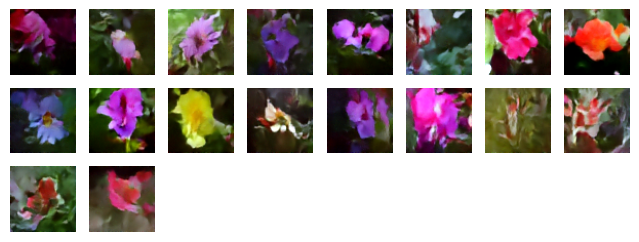

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1817 - n_loss: 0.1191
Epoch 24/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1845 - n_loss: 0.1178

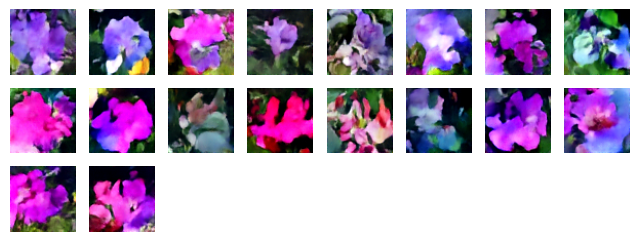

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1845 - n_loss: 0.1178
Epoch 25/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1824 - n_loss: 0.1182

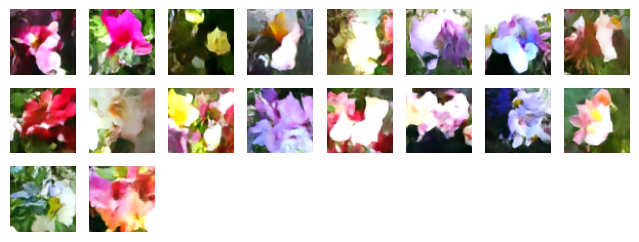

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - i_loss: 0.1824 - n_loss: 0.1181
Epoch 26/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1894 - n_loss: 0.1192

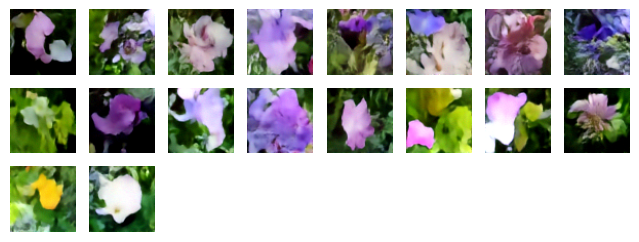

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1894 - n_loss: 0.1192
Epoch 27/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1829 - n_loss: 0.1176

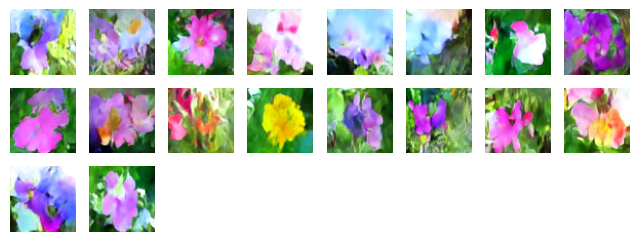

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1829 - n_loss: 0.1176
Epoch 28/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1839 - n_loss: 0.1185

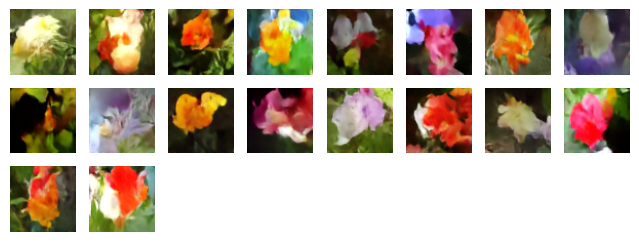

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1839 - n_loss: 0.1185
Epoch 29/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1806 - n_loss: 0.1173

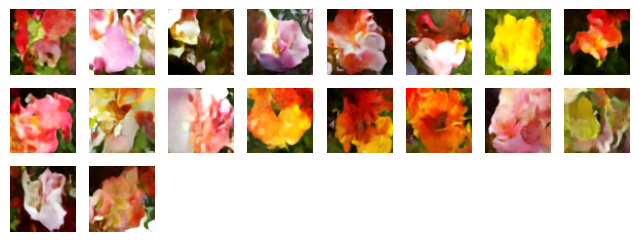

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1806 - n_loss: 0.1173
Epoch 30/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1837 - n_loss: 0.1169

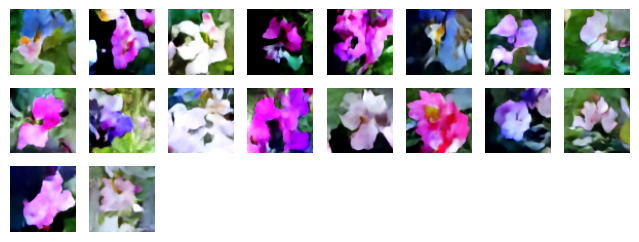

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1837 - n_loss: 0.1169
Epoch 31/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1798 - n_loss: 0.1181

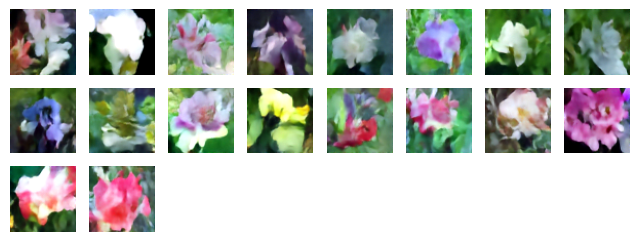

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1798 - n_loss: 0.1181
Epoch 32/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1819 - n_loss: 0.1170

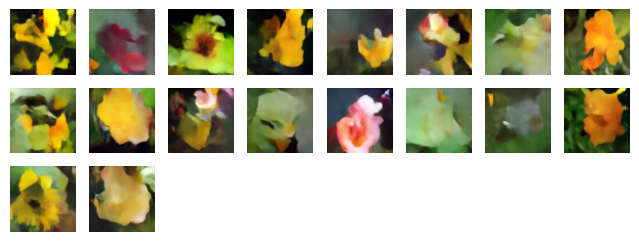

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1819 - n_loss: 0.1170
Epoch 33/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1801 - n_loss: 0.1159

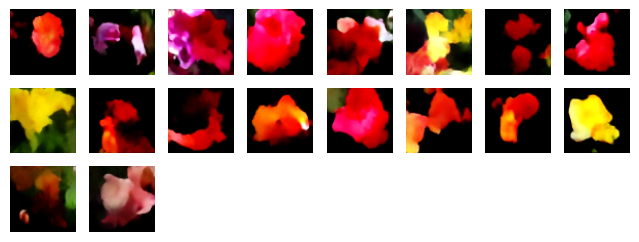

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1801 - n_loss: 0.1159
Epoch 34/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1795 - n_loss: 0.1162

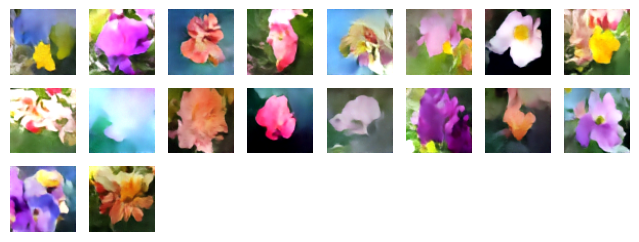

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - i_loss: 0.1795 - n_loss: 0.1162
Epoch 35/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1803 - n_loss: 0.1189

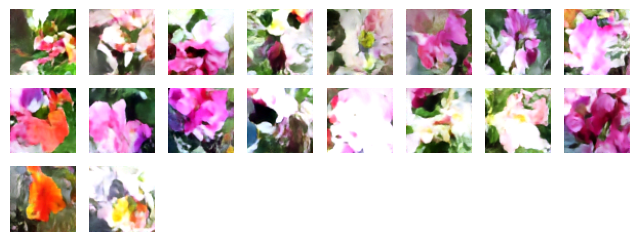

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1803 - n_loss: 0.1189
Epoch 36/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1840 - n_loss: 0.1165

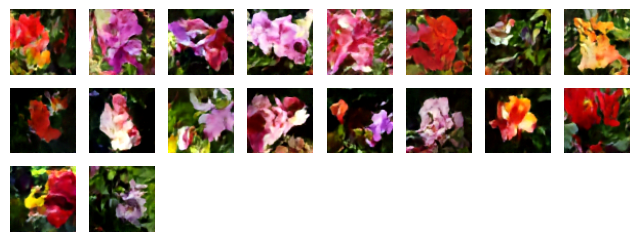

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1840 - n_loss: 0.1165
Epoch 37/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1804 - n_loss: 0.1173

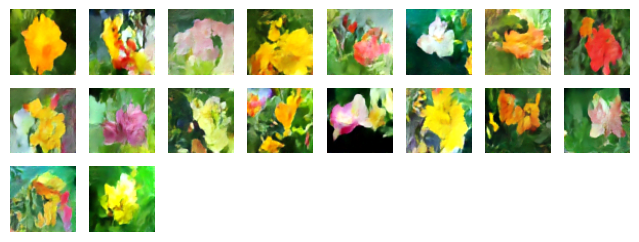

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1804 - n_loss: 0.1173
Epoch 38/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1826 - n_loss: 0.1184

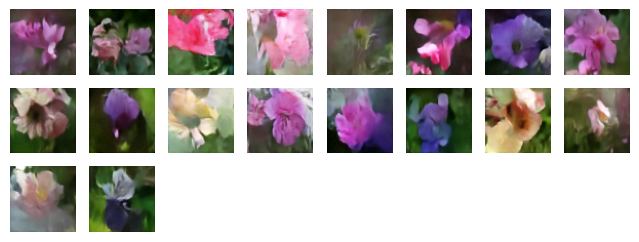

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1826 - n_loss: 0.1184
Epoch 39/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1816 - n_loss: 0.1174

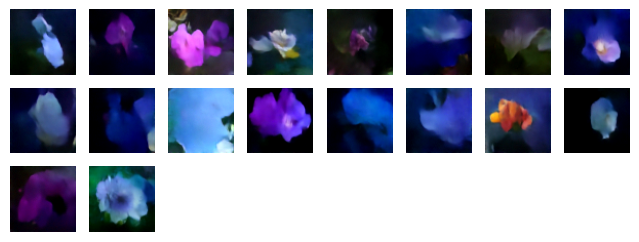

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1816 - n_loss: 0.1174
Epoch 40/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1778 - n_loss: 0.1151

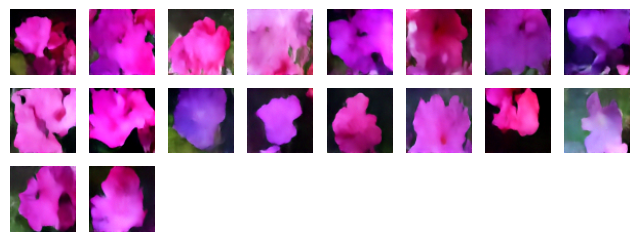

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1778 - n_loss: 0.1151
Epoch 41/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1800 - n_loss: 0.1171

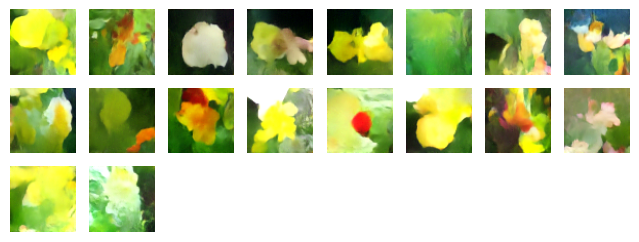

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1800 - n_loss: 0.1171
Epoch 42/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1770 - n_loss: 0.1169

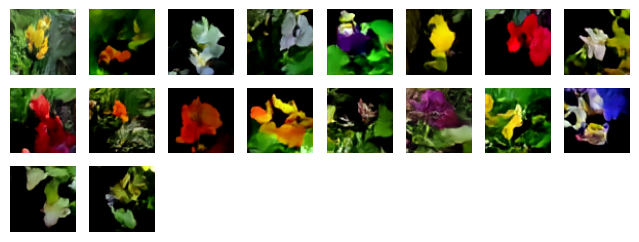

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1770 - n_loss: 0.1169
Epoch 43/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1764 - n_loss: 0.1152

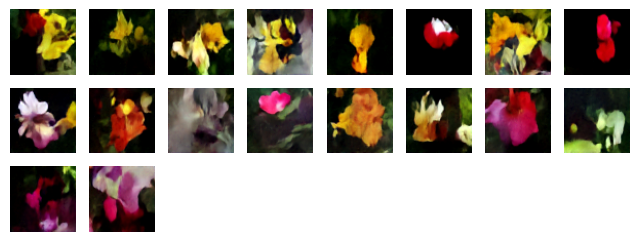

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - i_loss: 0.1764 - n_loss: 0.1152
Epoch 44/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1792 - n_loss: 0.1159

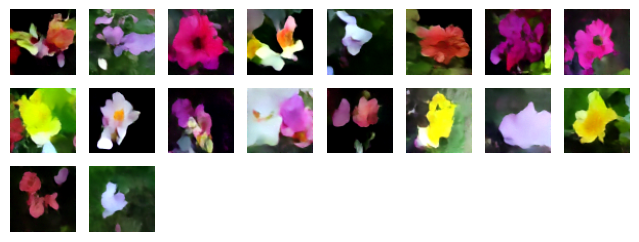

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1792 - n_loss: 0.1159
Epoch 45/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1761 - n_loss: 0.1172

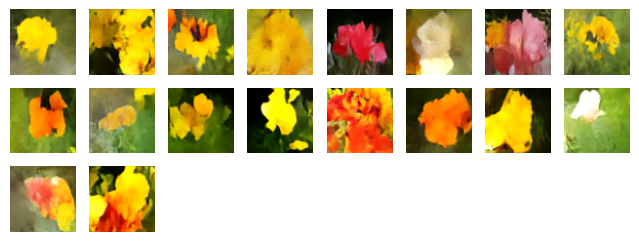

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1761 - n_loss: 0.1172
Epoch 46/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1777 - n_loss: 0.1163

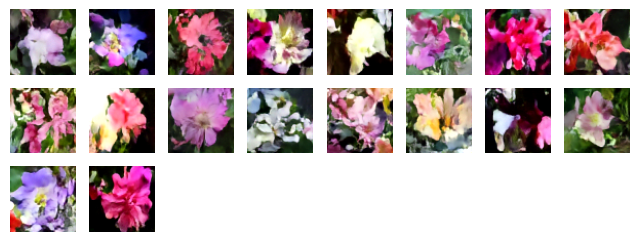

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1777 - n_loss: 0.1163
Epoch 47/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1752 - n_loss: 0.1163

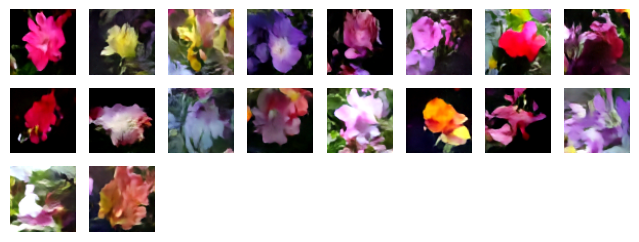

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1752 - n_loss: 0.1163
Epoch 48/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1762 - n_loss: 0.1160

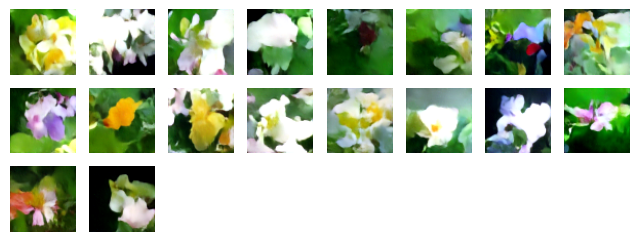

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1763 - n_loss: 0.1160
Epoch 49/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1736 - n_loss: 0.1152

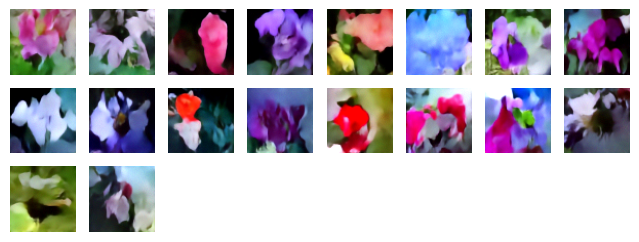

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1736 - n_loss: 0.1152
Epoch 50/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1750 - n_loss: 0.1165

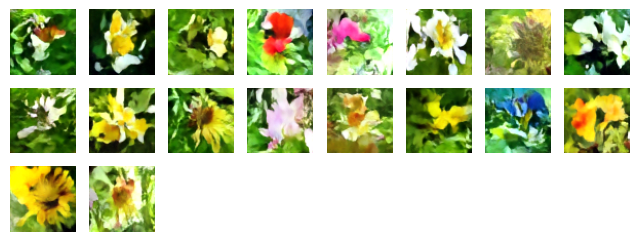

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1750 - n_loss: 0.1165
Epoch 51/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1732 - n_loss: 0.1159

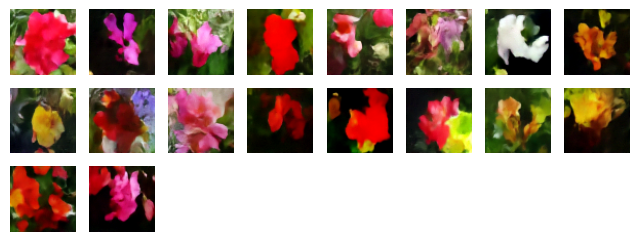

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1732 - n_loss: 0.1159
Epoch 52/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1761 - n_loss: 0.1160

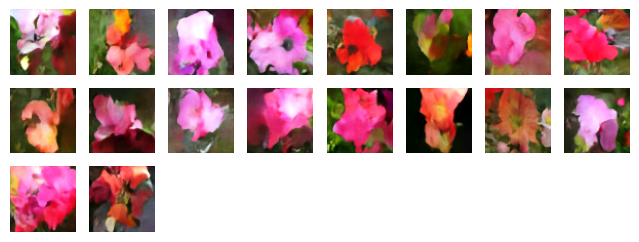

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - i_loss: 0.1761 - n_loss: 0.1160
Epoch 53/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1751 - n_loss: 0.1158

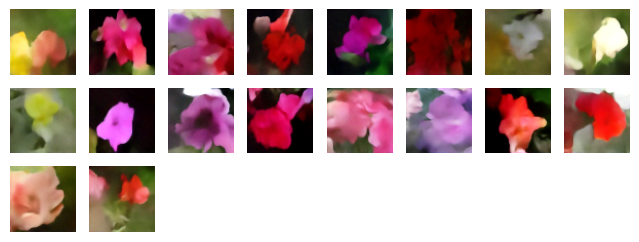

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1751 - n_loss: 0.1158
Epoch 54/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1798 - n_loss: 0.1129

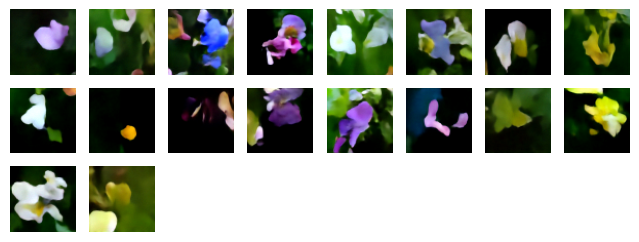

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1798 - n_loss: 0.1129
Epoch 55/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1749 - n_loss: 0.1150

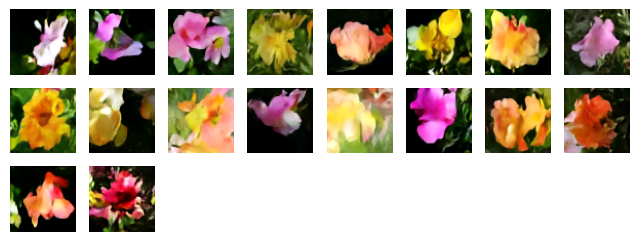

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - i_loss: 0.1749 - n_loss: 0.1150
Epoch 56/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - i_loss: 0.1768 - n_loss: 0.1157

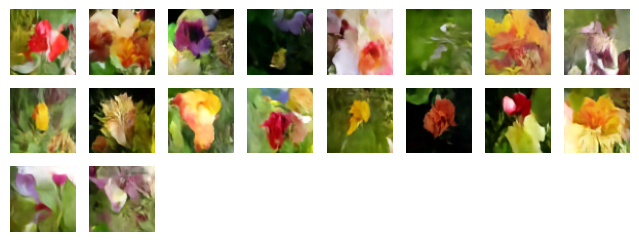

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 49ms/step - i_loss: 0.1768 - n_loss: 0.1157
Epoch 57/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - i_loss: 0.1760 - n_loss: 0.1154

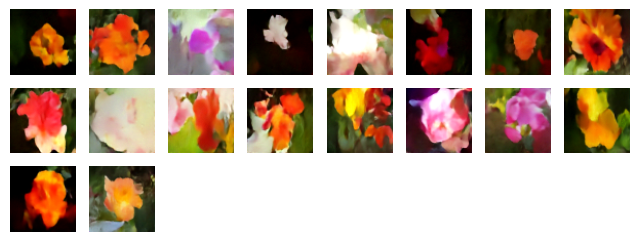

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - i_loss: 0.1760 - n_loss: 0.1154
Epoch 58/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1781 - n_loss: 0.1149

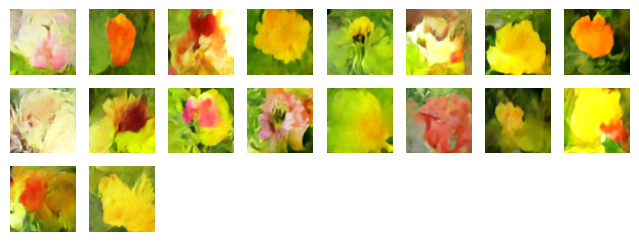

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1781 - n_loss: 0.1149
Epoch 59/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1790 - n_loss: 0.1137

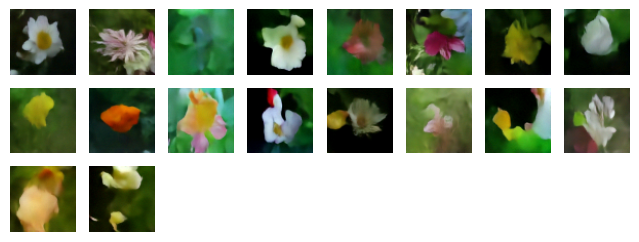

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1790 - n_loss: 0.1137
Epoch 60/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1783 - n_loss: 0.1131

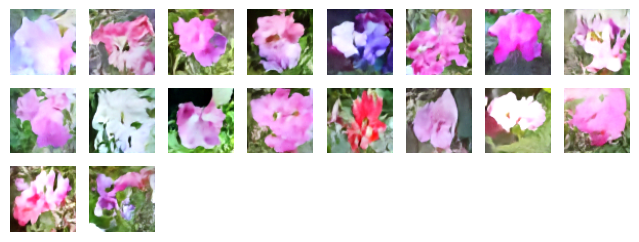

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - i_loss: 0.1783 - n_loss: 0.1131
Epoch 61/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1763 - n_loss: 0.1133

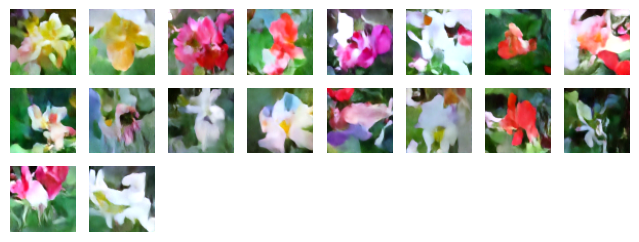

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1763 - n_loss: 0.1133
Epoch 62/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1754 - n_loss: 0.1141

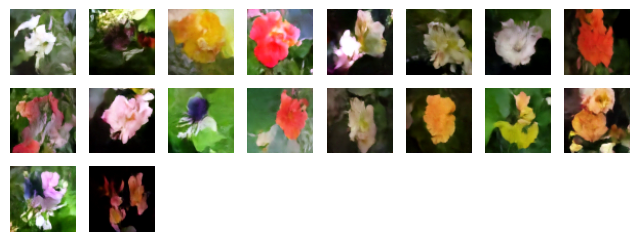

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - i_loss: 0.1754 - n_loss: 0.1141
Epoch 63/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1736 - n_loss: 0.1156

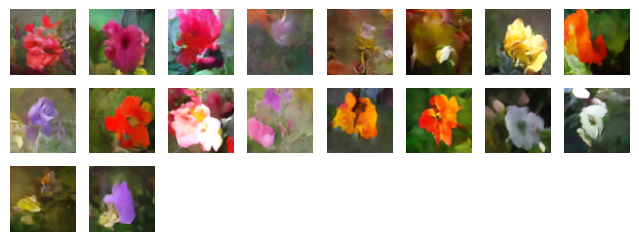

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - i_loss: 0.1736 - n_loss: 0.1156
Epoch 64/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1745 - n_loss: 0.1144

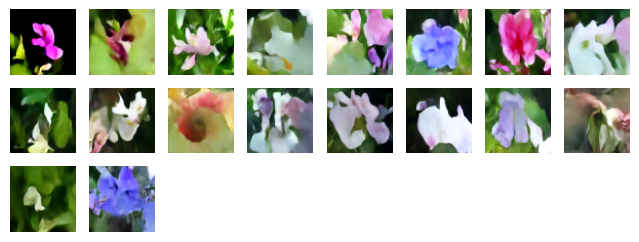

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - i_loss: 0.1745 - n_loss: 0.1144
Epoch 65/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - i_loss: 0.1761 - n_loss: 0.1129

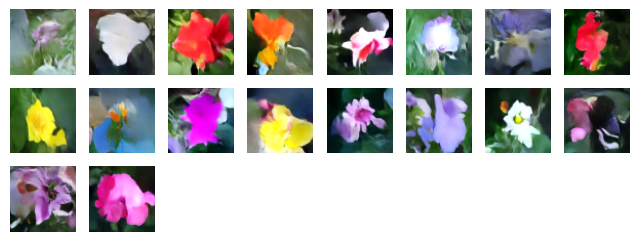

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 49ms/step - i_loss: 0.1761 - n_loss: 0.1129
Epoch 66/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1801 - n_loss: 0.1119

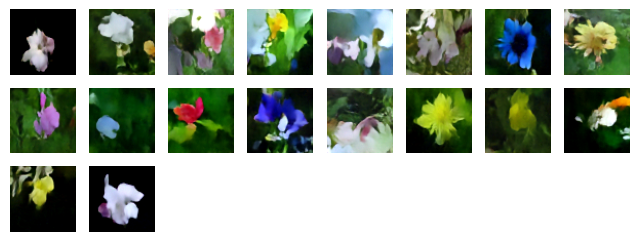

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1801 - n_loss: 0.1120
Epoch 67/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1766 - n_loss: 0.1138

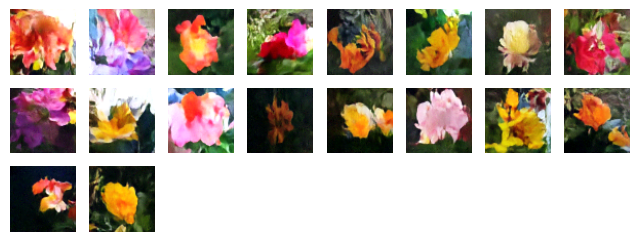

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1765 - n_loss: 0.1138
Epoch 68/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1744 - n_loss: 0.1129

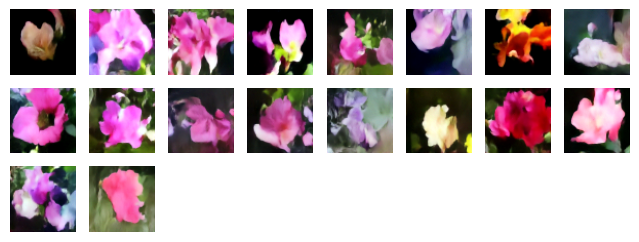

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1744 - n_loss: 0.1129
Epoch 69/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1737 - n_loss: 0.1140

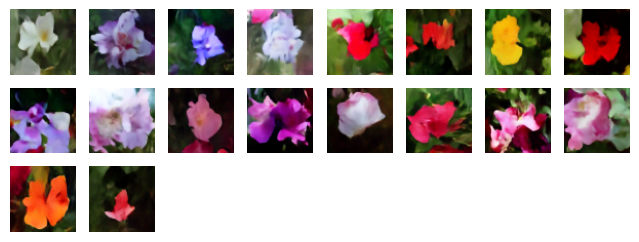

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - i_loss: 0.1738 - n_loss: 0.1140
Epoch 70/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1762 - n_loss: 0.1146

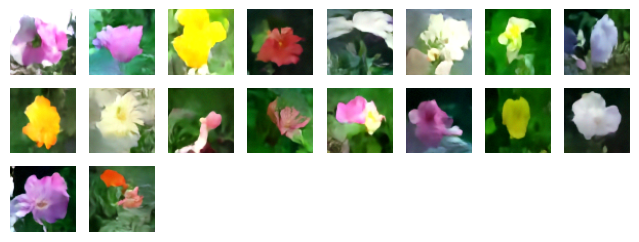

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1762 - n_loss: 0.1146
Epoch 71/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1776 - n_loss: 0.1128

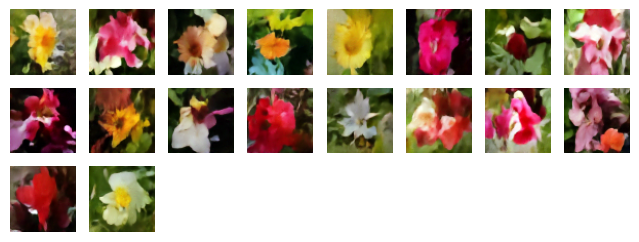

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1776 - n_loss: 0.1128
Epoch 72/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1771 - n_loss: 0.1133

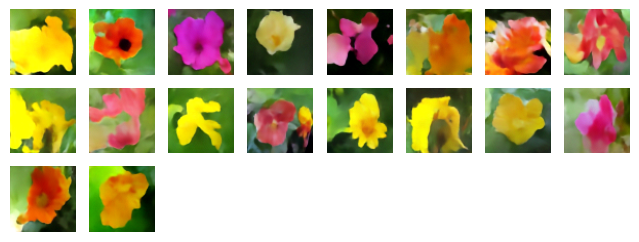

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1771 - n_loss: 0.1133
Epoch 73/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1752 - n_loss: 0.1142

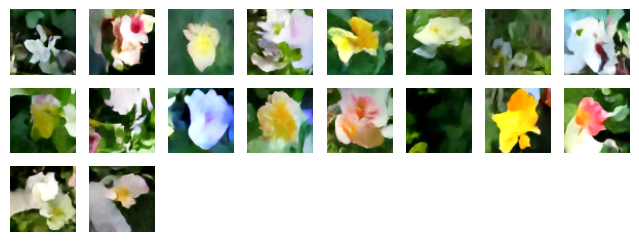

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1752 - n_loss: 0.1142
Epoch 74/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1717 - n_loss: 0.1132

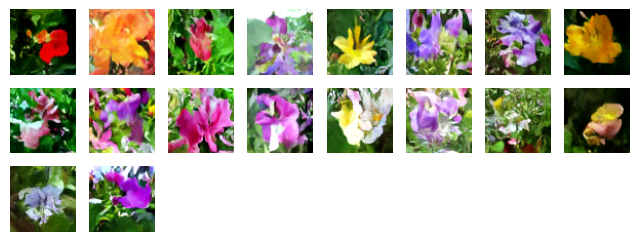

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1717 - n_loss: 0.1132
Epoch 75/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1737 - n_loss: 0.1145

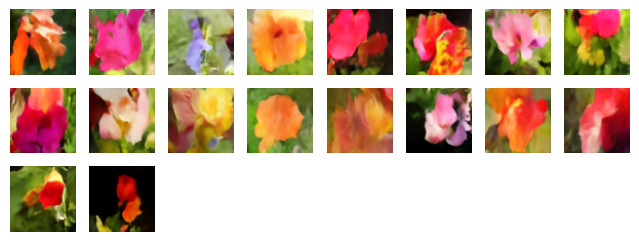

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1737 - n_loss: 0.1145
Epoch 76/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1742 - n_loss: 0.1132

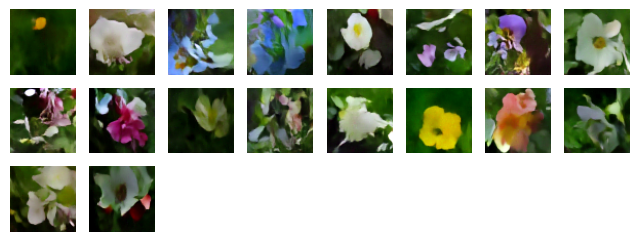

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - i_loss: 0.1742 - n_loss: 0.1132
Epoch 77/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1729 - n_loss: 0.1138

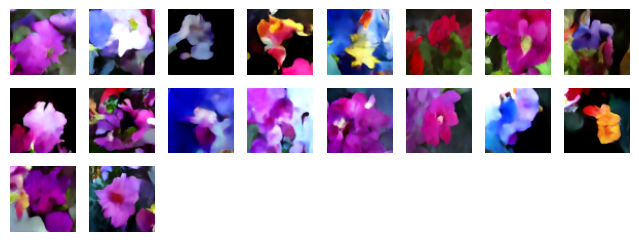

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 51ms/step - i_loss: 0.1729 - n_loss: 0.1138
Epoch 78/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1759 - n_loss: 0.1131

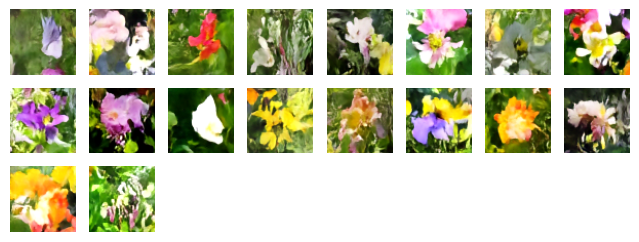

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1759 - n_loss: 0.1131
Epoch 79/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1720 - n_loss: 0.1142

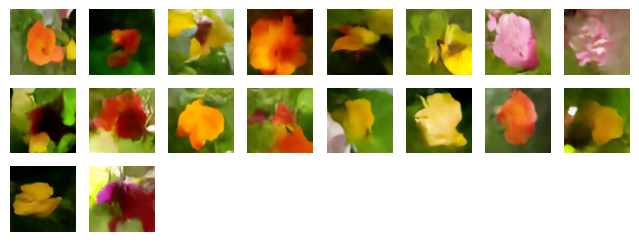

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1720 - n_loss: 0.1142
Epoch 80/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1732 - n_loss: 0.1139

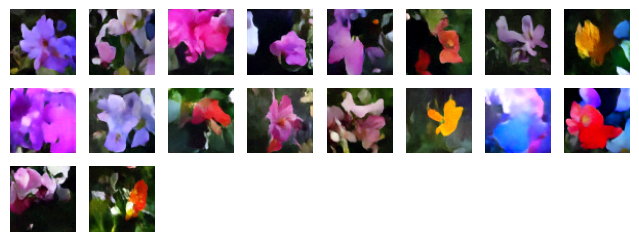

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1732 - n_loss: 0.1139
Epoch 81/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1735 - n_loss: 0.1144

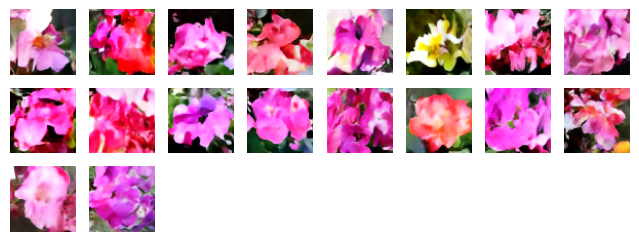

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1735 - n_loss: 0.1144
Epoch 82/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1724 - n_loss: 0.1135

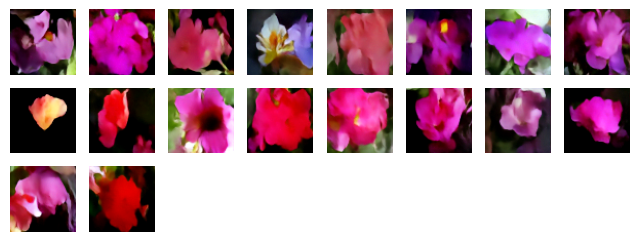

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1724 - n_loss: 0.1135
Epoch 83/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1766 - n_loss: 0.1140

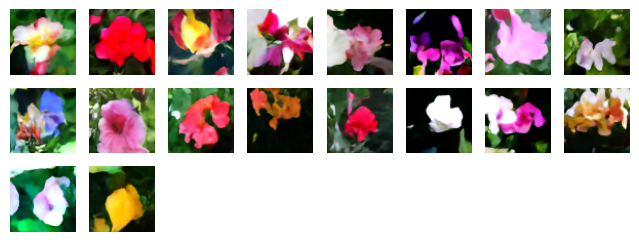

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1766 - n_loss: 0.1140
Epoch 84/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1769 - n_loss: 0.1140

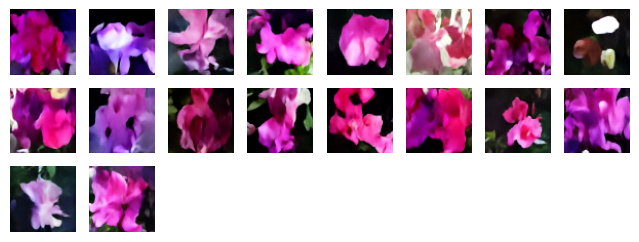

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1769 - n_loss: 0.1140
Epoch 85/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1734 - n_loss: 0.1130

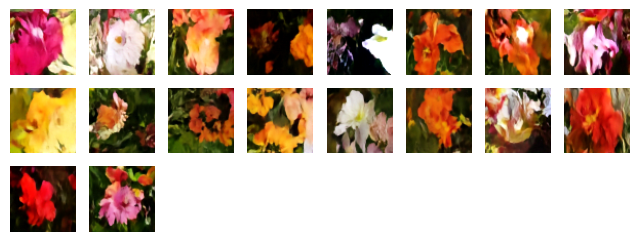

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1734 - n_loss: 0.1130
Epoch 86/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1736 - n_loss: 0.1130

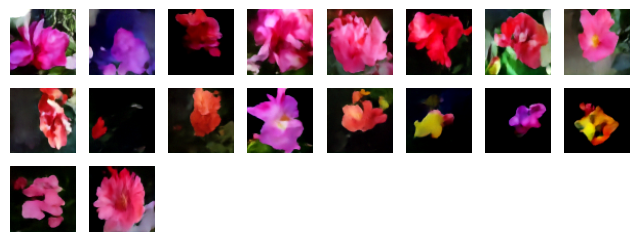

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - i_loss: 0.1736 - n_loss: 0.1130
Epoch 87/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1733 - n_loss: 0.1139

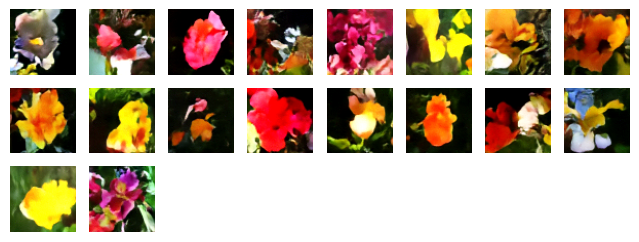

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1733 - n_loss: 0.1139
Epoch 88/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1719 - n_loss: 0.1138

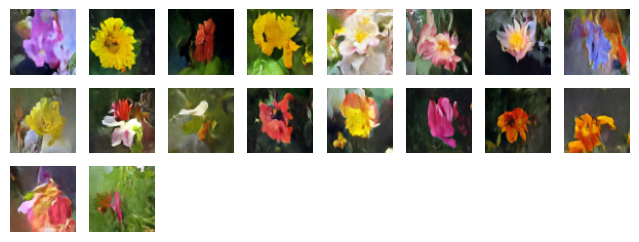

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1719 - n_loss: 0.1138
Epoch 89/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1725 - n_loss: 0.1128

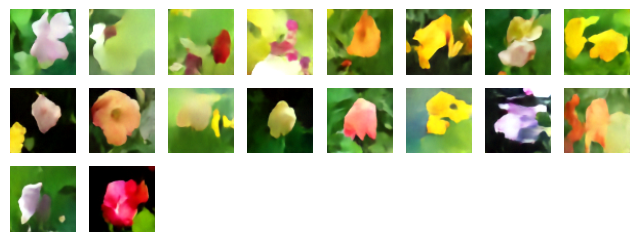

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1725 - n_loss: 0.1128
Epoch 90/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1766 - n_loss: 0.1136

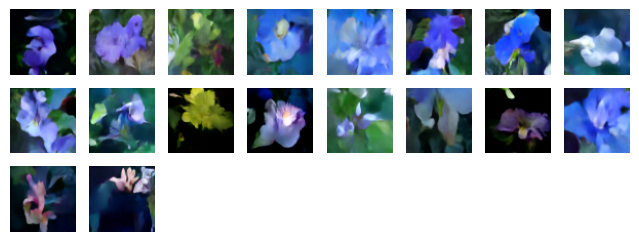

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1766 - n_loss: 0.1136
Epoch 91/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1735 - n_loss: 0.1111

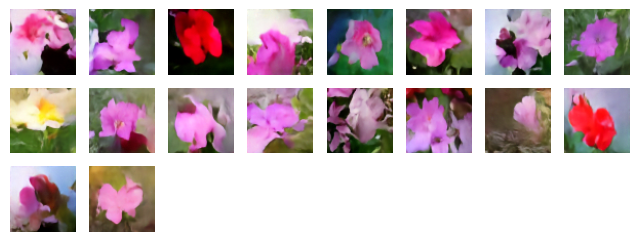

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 49ms/step - i_loss: 0.1735 - n_loss: 0.1111
Epoch 92/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1701 - n_loss: 0.1143

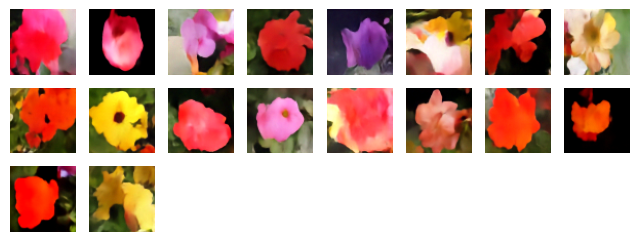

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1701 - n_loss: 0.1143
Epoch 93/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1720 - n_loss: 0.1135

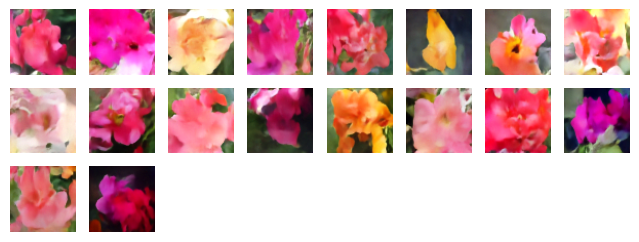

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1719 - n_loss: 0.1135
Epoch 94/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1745 - n_loss: 0.1125

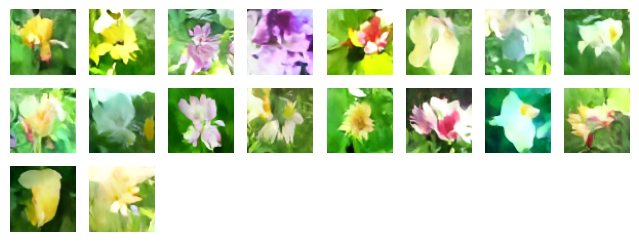

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - i_loss: 0.1745 - n_loss: 0.1125
Epoch 95/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1710 - n_loss: 0.1133

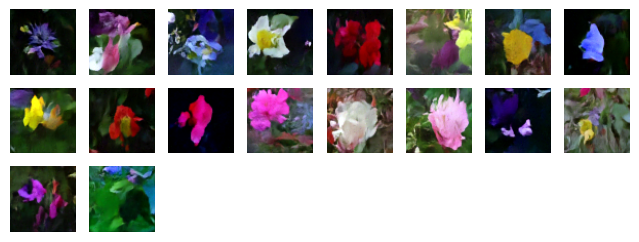

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - i_loss: 0.1711 - n_loss: 0.1133
Epoch 96/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1736 - n_loss: 0.1122

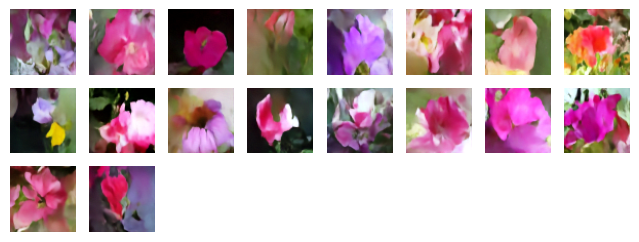

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 46ms/step - i_loss: 0.1736 - n_loss: 0.1122
Epoch 97/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - i_loss: 0.1727 - n_loss: 0.1126

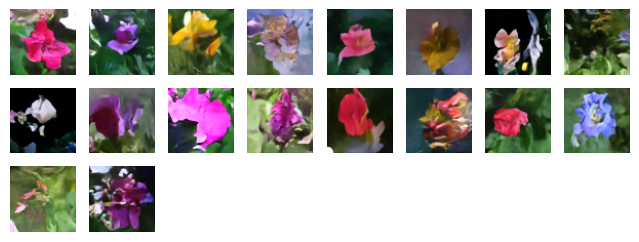

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - i_loss: 0.1727 - n_loss: 0.1126
Epoch 98/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1741 - n_loss: 0.1125

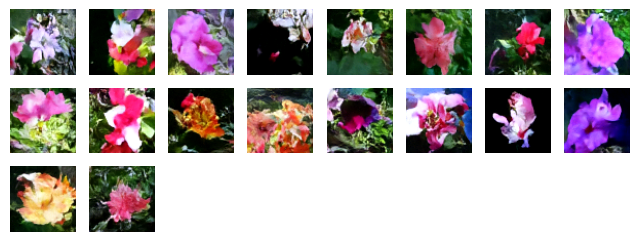

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1741 - n_loss: 0.1125
Epoch 99/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - i_loss: 0.1702 - n_loss: 0.1128

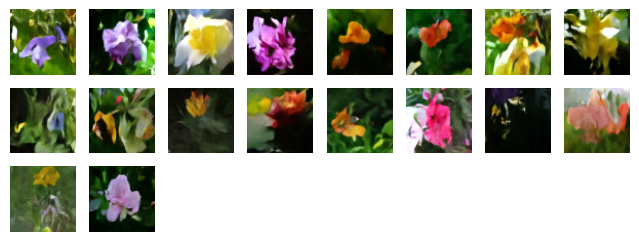

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - i_loss: 0.1702 - n_loss: 0.1128
Epoch 100/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - i_loss: 0.1747 - n_loss: 0.1117

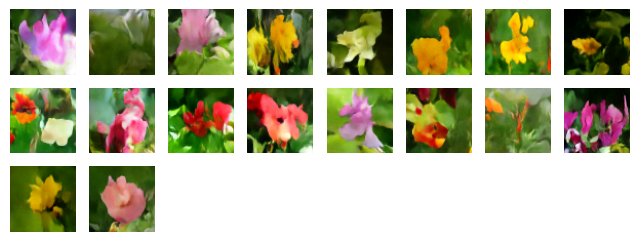

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1747 - n_loss: 0.1117
Epoch 101/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1716 - n_loss: 0.1119

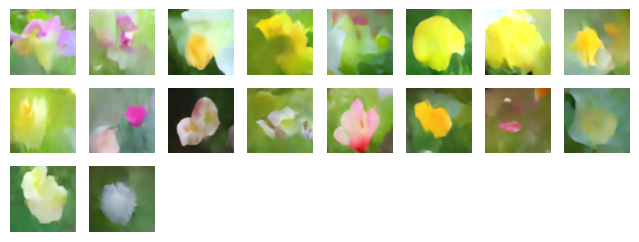

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 50ms/step - i_loss: 0.1716 - n_loss: 0.1119
Epoch 102/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - i_loss: 0.1737 - n_loss: 0.1146

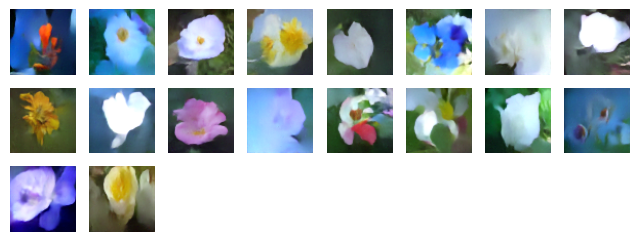

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 50ms/step - i_loss: 0.1737 - n_loss: 0.1146
Epoch 103/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - i_loss: 0.1720 - n_loss: 0.1125

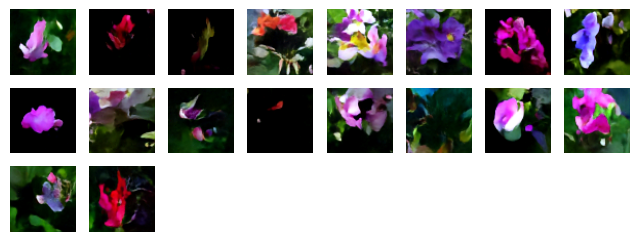

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 64ms/step - i_loss: 0.1720 - n_loss: 0.1125
Epoch 104/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - i_loss: 0.1712 - n_loss: 0.1127

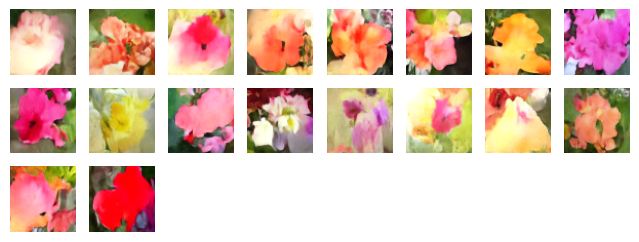

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 54ms/step - i_loss: 0.1712 - n_loss: 0.1127
Epoch 105/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step - i_loss: 0.1700 - n_loss: 0.1142

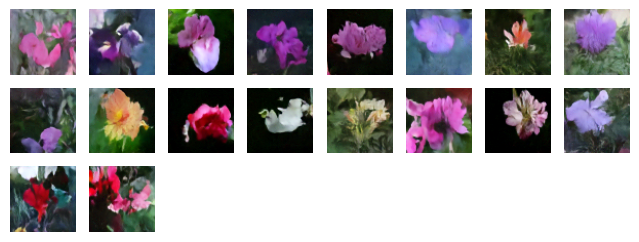

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - i_loss: 0.1701 - n_loss: 0.1142
Epoch 106/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1702 - n_loss: 0.1132

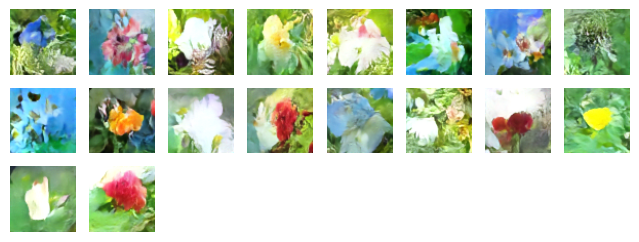

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 48ms/step - i_loss: 0.1702 - n_loss: 0.1131
Epoch 107/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1706 - n_loss: 0.1115

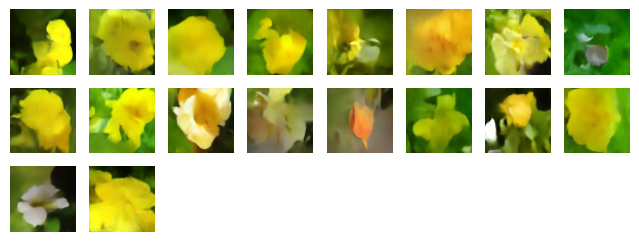

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1707 - n_loss: 0.1115
Epoch 108/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1725 - n_loss: 0.1139

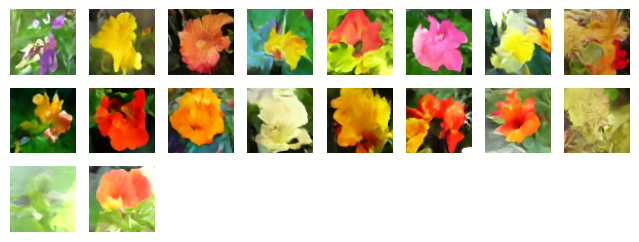

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1725 - n_loss: 0.1139
Epoch 109/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - i_loss: 0.1726 - n_loss: 0.1134

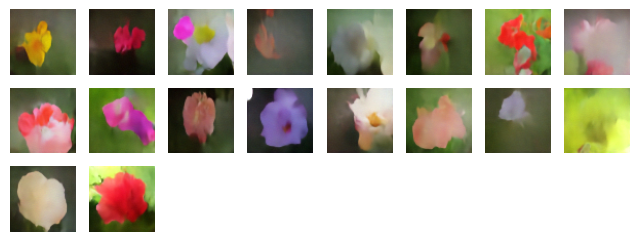

127/127 ━━━━━━━━━━━━━━━━━━━━ 6s 47ms/step - i_loss: 0.1726 - n_loss: 0.1134
Epoch 110/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - i_loss: 0.1695 - n_loss: 0.1130

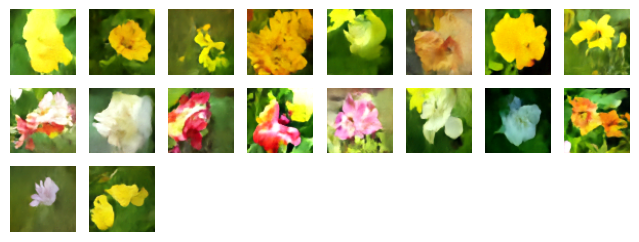

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1695 - n_loss: 0.1130
Epoch 111/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - i_loss: 0.1700 - n_loss: 0.1133

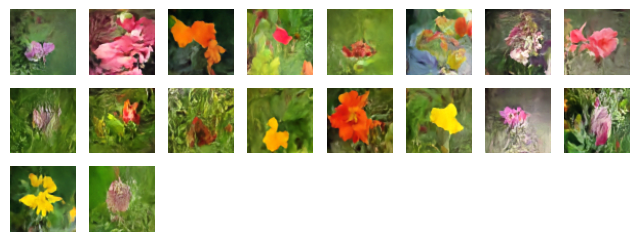

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 74ms/step - i_loss: 0.1700 - n_loss: 0.1133
Epoch 112/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - i_loss: 0.1717 - n_loss: 0.1120

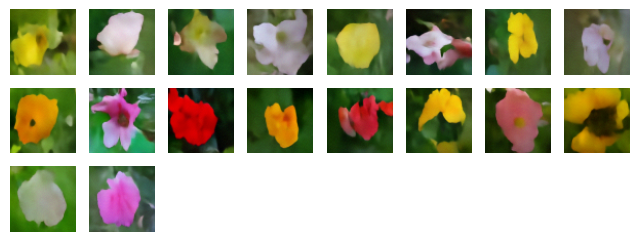

127/127 ━━━━━━━━━━━━━━━━━━━━ 10s 80ms/step - i_loss: 0.1717 - n_loss: 0.1120
Epoch 113/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1714 - n_loss: 0.1121

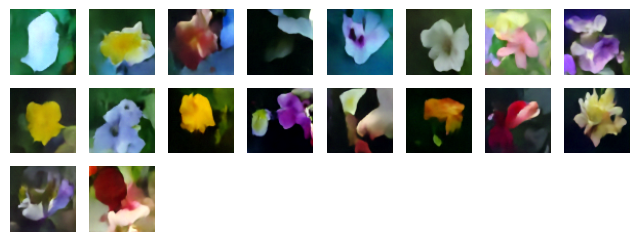

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1714 - n_loss: 0.1121
Epoch 114/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1718 - n_loss: 0.1132

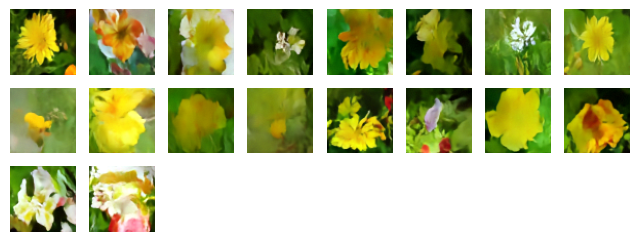

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 69ms/step - i_loss: 0.1718 - n_loss: 0.1132
Epoch 115/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1688 - n_loss: 0.1129

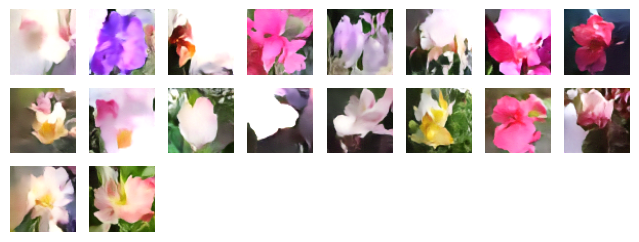

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1688 - n_loss: 0.1129
Epoch 116/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1715 - n_loss: 0.1125

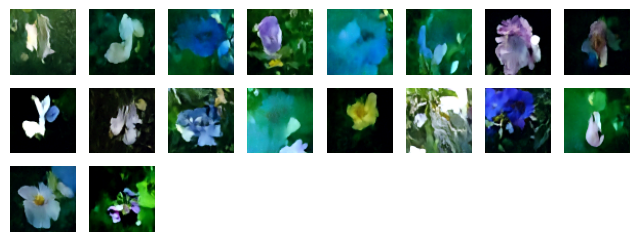

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1715 - n_loss: 0.1125
Epoch 117/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1698 - n_loss: 0.1131

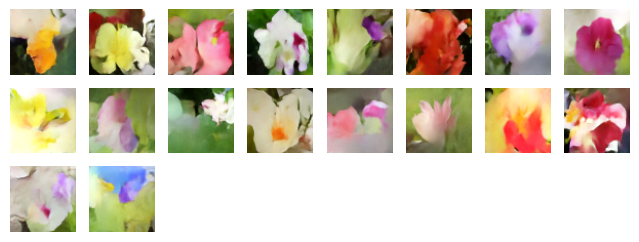

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1698 - n_loss: 0.1131
Epoch 118/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1723 - n_loss: 0.1105

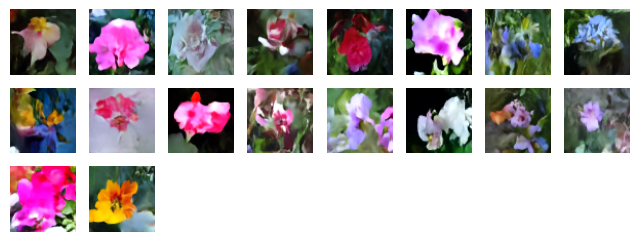

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1723 - n_loss: 0.1105
Epoch 119/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1701 - n_loss: 0.1125

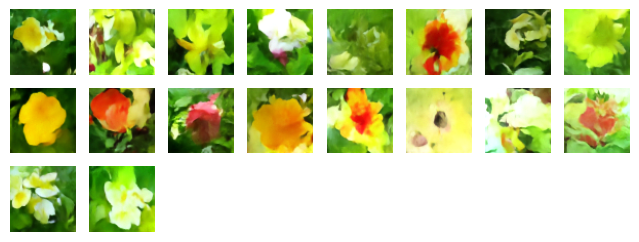

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 70ms/step - i_loss: 0.1702 - n_loss: 0.1125
Epoch 120/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1700 - n_loss: 0.1128

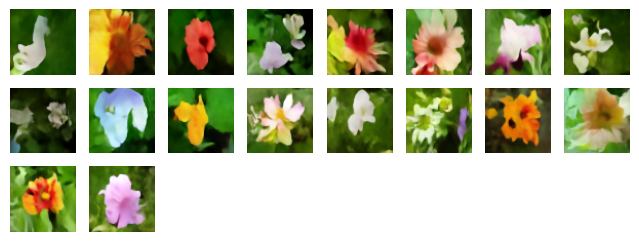

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1700 - n_loss: 0.1128
Epoch 121/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1690 - n_loss: 0.1130

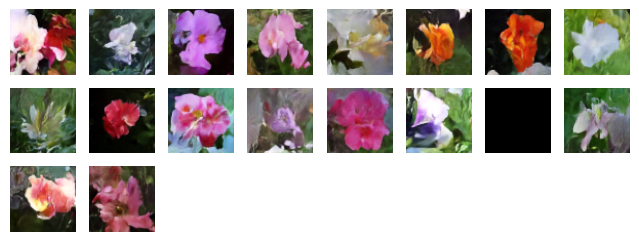

127/127 ━━━━━━━━━━━━━━━━━━━━ 10s 78ms/step - i_loss: 0.1690 - n_loss: 0.1130
Epoch 122/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1705 - n_loss: 0.1125

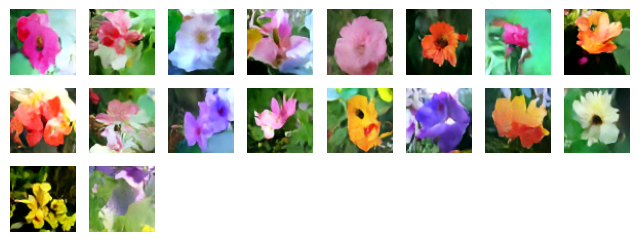

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1705 - n_loss: 0.1125
Epoch 123/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1717 - n_loss: 0.1124

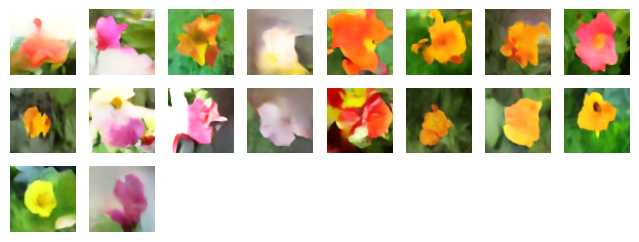

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1717 - n_loss: 0.1124
Epoch 124/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - i_loss: 0.1735 - n_loss: 0.1102

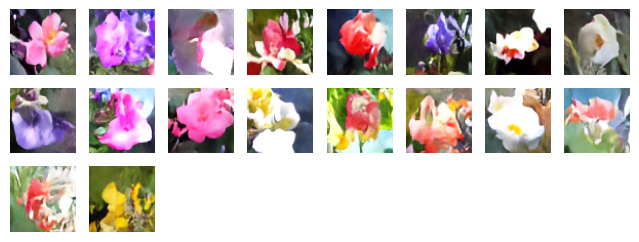

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 67ms/step - i_loss: 0.1735 - n_loss: 0.1102
Epoch 125/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1723 - n_loss: 0.1120

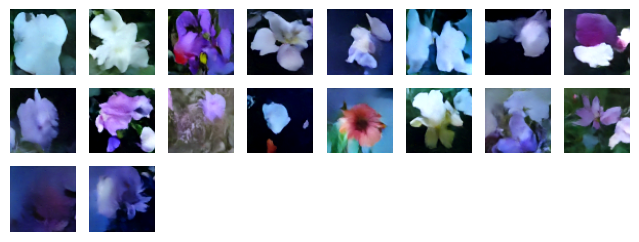

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1723 - n_loss: 0.1120
Epoch 126/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1712 - n_loss: 0.1122

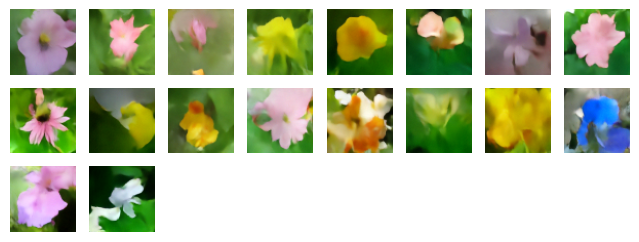

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1712 - n_loss: 0.1122
Epoch 127/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1695 - n_loss: 0.1133

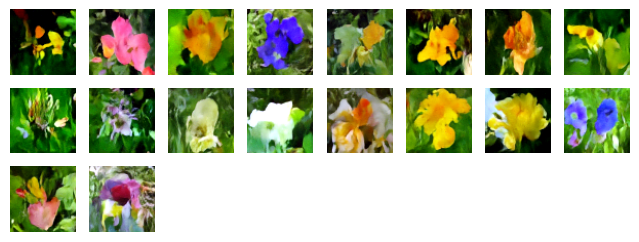

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1695 - n_loss: 0.1133
Epoch 128/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1718 - n_loss: 0.1119

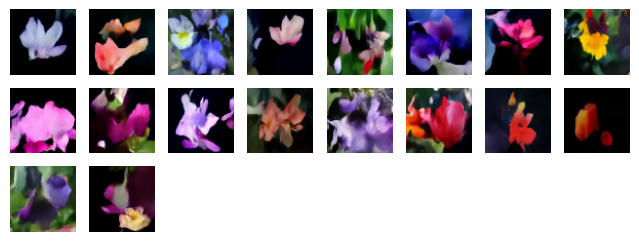

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1718 - n_loss: 0.1119
Epoch 129/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - i_loss: 0.1731 - n_loss: 0.1114

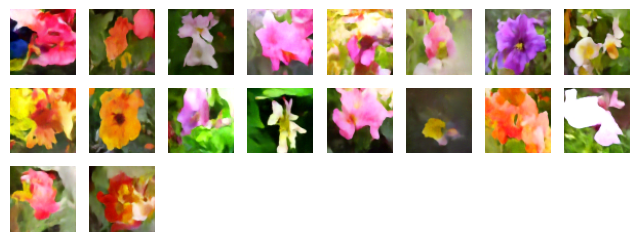

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1731 - n_loss: 0.1114
Epoch 130/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1762 - n_loss: 0.1113

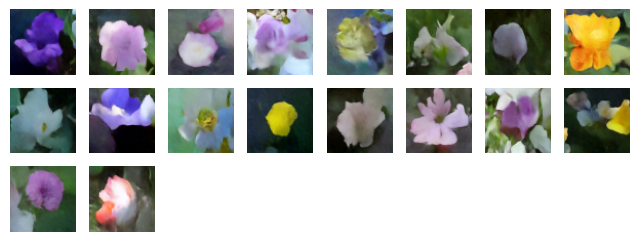

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1762 - n_loss: 0.1113
Epoch 131/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1744 - n_loss: 0.1112

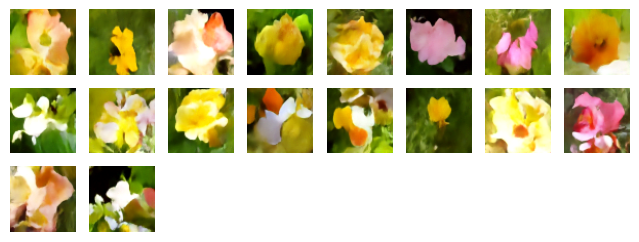

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1744 - n_loss: 0.1112
Epoch 132/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - i_loss: 0.1708 - n_loss: 0.1126

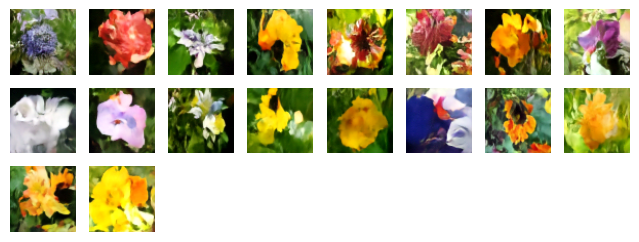

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1708 - n_loss: 0.1126
Epoch 133/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1690 - n_loss: 0.1133

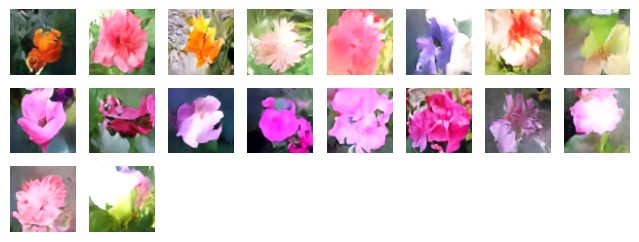

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1690 - n_loss: 0.1132
Epoch 134/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - i_loss: 0.1686 - n_loss: 0.1128

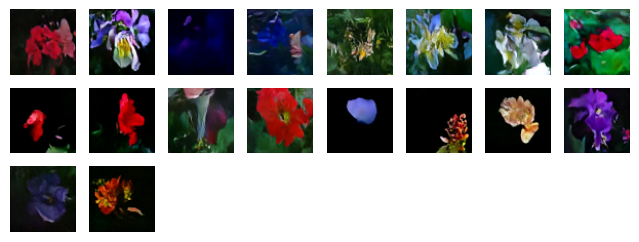

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 65ms/step - i_loss: 0.1686 - n_loss: 0.1128
Epoch 135/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1736 - n_loss: 0.1100

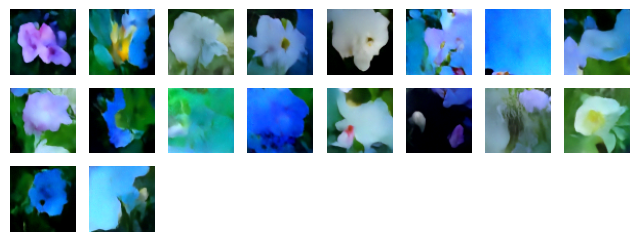

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1736 - n_loss: 0.1100
Epoch 136/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1764 - n_loss: 0.1105

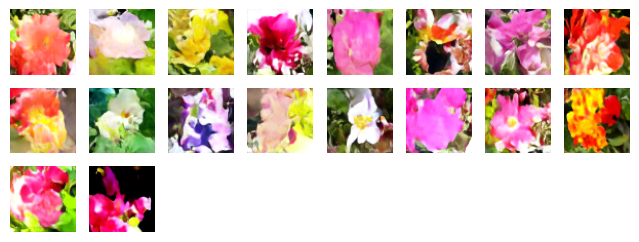

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1764 - n_loss: 0.1105
Epoch 137/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1720 - n_loss: 0.1116

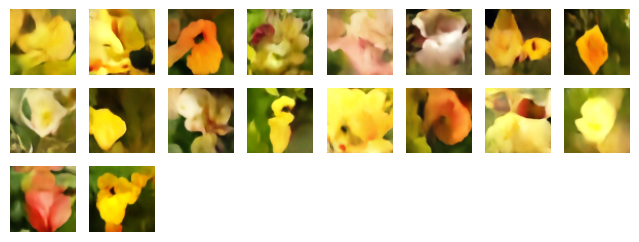

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1720 - n_loss: 0.1116
Epoch 138/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1708 - n_loss: 0.1123

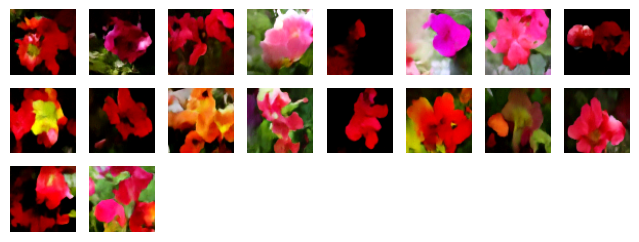

127/127 ━━━━━━━━━━━━━━━━━━━━ 10s 78ms/step - i_loss: 0.1708 - n_loss: 0.1123
Epoch 139/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - i_loss: 0.1709 - n_loss: 0.1123

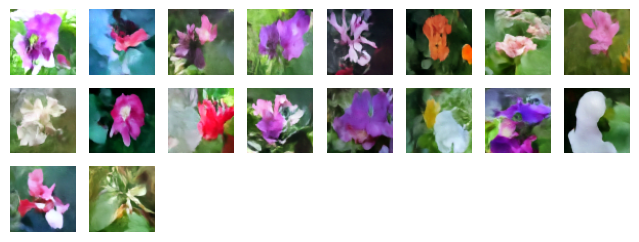

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 62ms/step - i_loss: 0.1709 - n_loss: 0.1123
Epoch 140/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1715 - n_loss: 0.1113

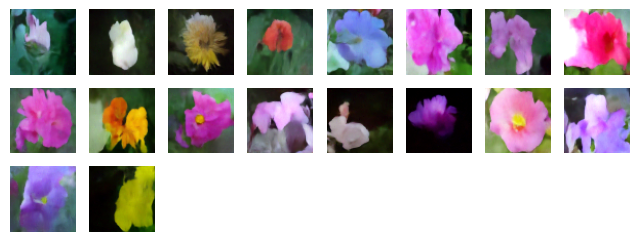

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1714 - n_loss: 0.1113
Epoch 141/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1703 - n_loss: 0.1119

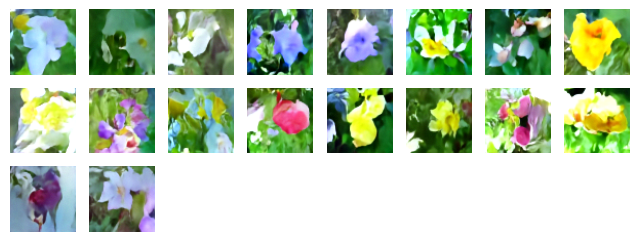

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1703 - n_loss: 0.1119
Epoch 142/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1724 - n_loss: 0.1116

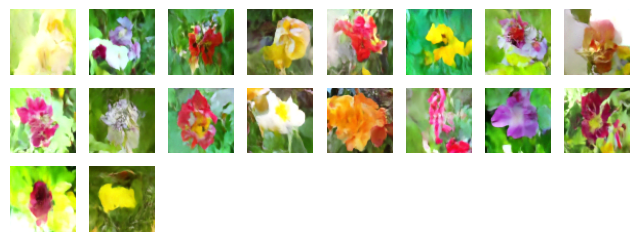

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1724 - n_loss: 0.1116
Epoch 143/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1690 - n_loss: 0.1118

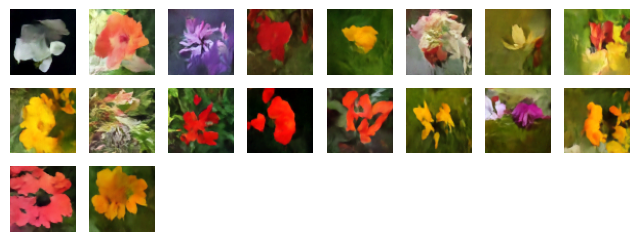

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1690 - n_loss: 0.1118
Epoch 144/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - i_loss: 0.1695 - n_loss: 0.1121

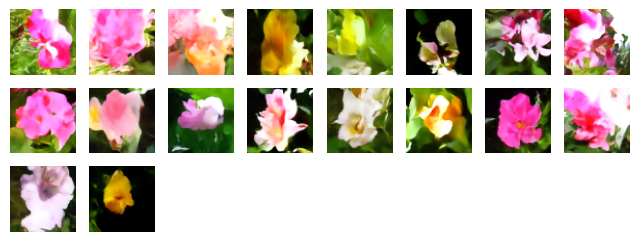

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 62ms/step - i_loss: 0.1695 - n_loss: 0.1121
Epoch 145/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1701 - n_loss: 0.1128

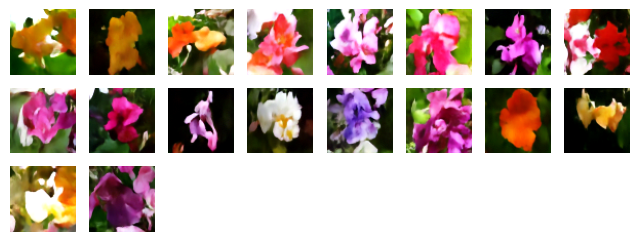

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1701 - n_loss: 0.1128
Epoch 146/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1702 - n_loss: 0.1101

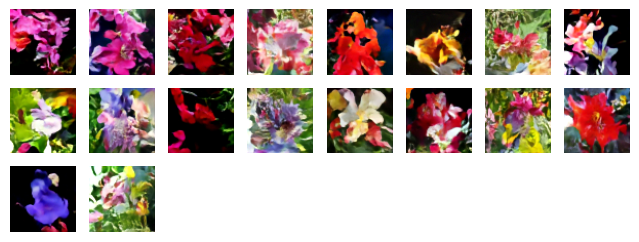

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1702 - n_loss: 0.1101
Epoch 147/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1709 - n_loss: 0.1117

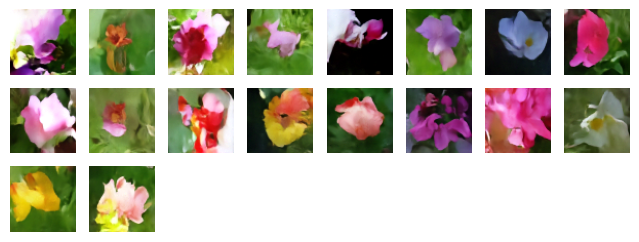

127/127 ━━━━━━━━━━━━━━━━━━━━ 10s 78ms/step - i_loss: 0.1709 - n_loss: 0.1117
Epoch 148/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1708 - n_loss: 0.1117

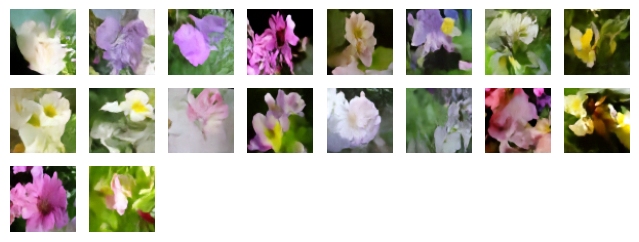

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1708 - n_loss: 0.1117
Epoch 149/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - i_loss: 0.1686 - n_loss: 0.1119

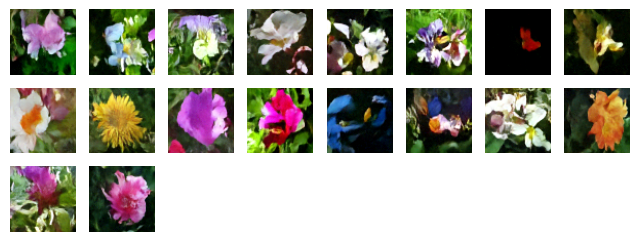

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 59ms/step - i_loss: 0.1687 - n_loss: 0.1119
Epoch 150/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1707 - n_loss: 0.1117

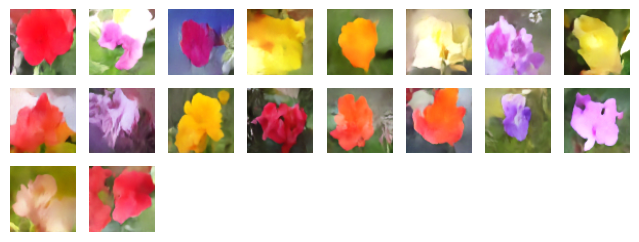

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1707 - n_loss: 0.1117
Epoch 151/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - i_loss: 0.1707 - n_loss: 0.1128

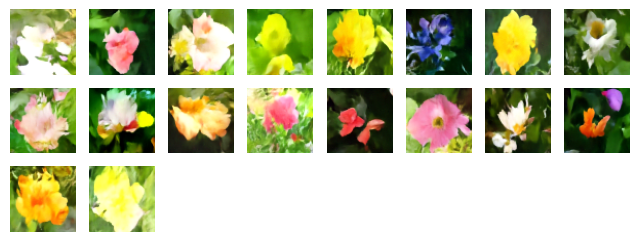

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1707 - n_loss: 0.1128
Epoch 152/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1695 - n_loss: 0.1109

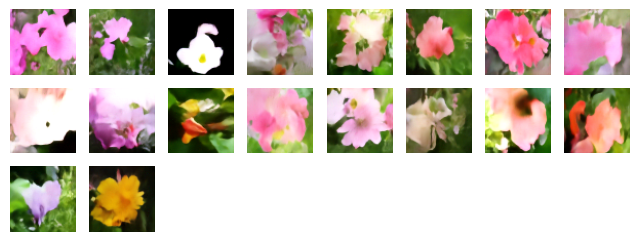

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1695 - n_loss: 0.1109
Epoch 153/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1711 - n_loss: 0.1116

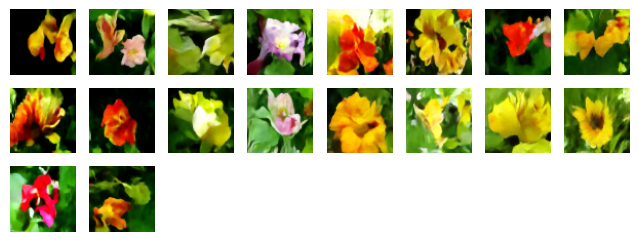

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1711 - n_loss: 0.1116
Epoch 154/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - i_loss: 0.1727 - n_loss: 0.1121

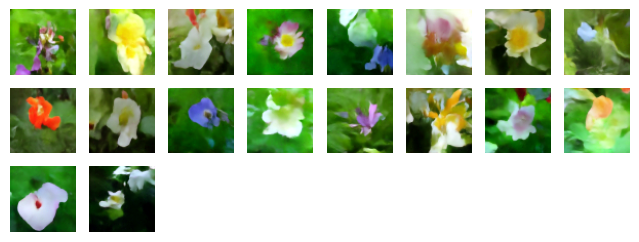

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 61ms/step - i_loss: 0.1726 - n_loss: 0.1121
Epoch 155/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1712 - n_loss: 0.1103

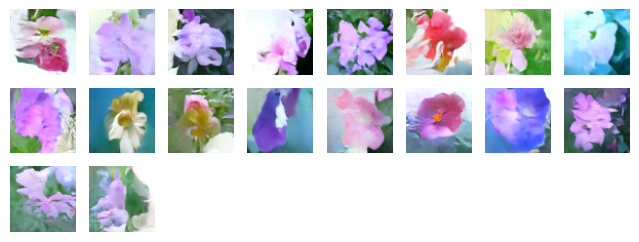

127/127 ━━━━━━━━━━━━━━━━━━━━ 10s 78ms/step - i_loss: 0.1712 - n_loss: 0.1103
Epoch 156/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1707 - n_loss: 0.1124

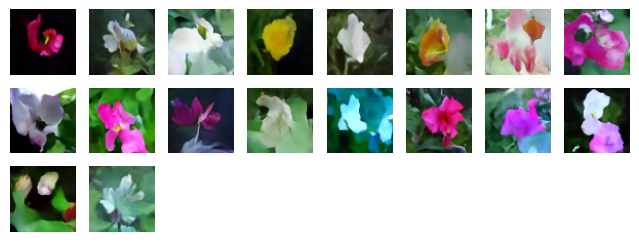

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1707 - n_loss: 0.1124
Epoch 157/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1683 - n_loss: 0.1121

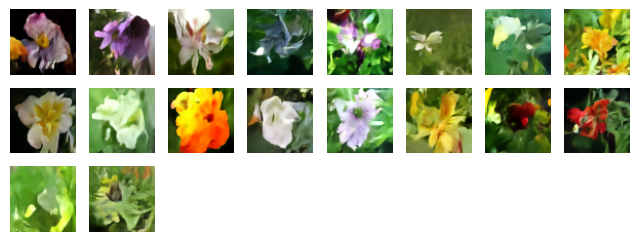

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1682 - n_loss: 0.1121
Epoch 158/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1685 - n_loss: 0.1119

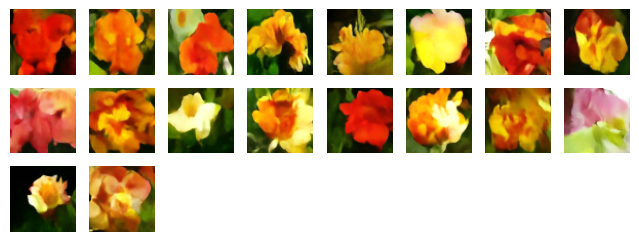

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 71ms/step - i_loss: 0.1685 - n_loss: 0.1119
Epoch 159/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - i_loss: 0.1695 - n_loss: 0.1123

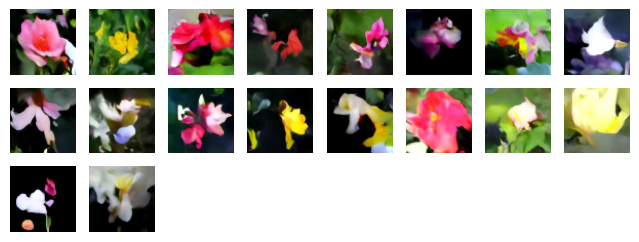

127/127 ━━━━━━━━━━━━━━━━━━━━ 7s 59ms/step - i_loss: 0.1695 - n_loss: 0.1123
Epoch 160/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1722 - n_loss: 0.1108

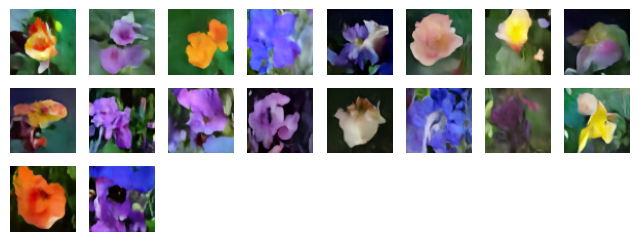

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1722 - n_loss: 0.1108
Epoch 161/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1710 - n_loss: 0.1105

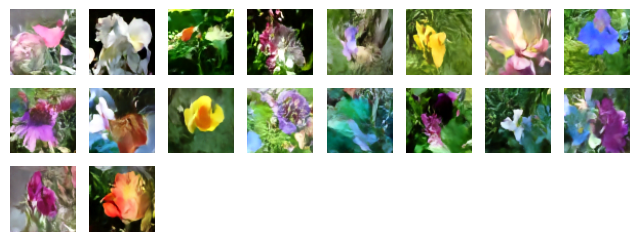

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1710 - n_loss: 0.1105
Epoch 162/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1695 - n_loss: 0.1138

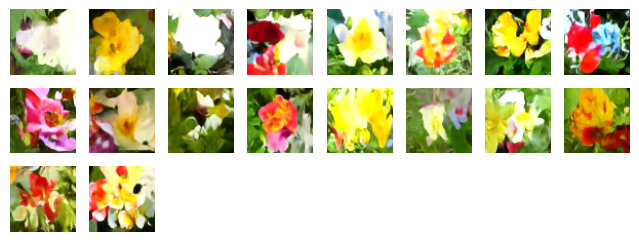

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1695 - n_loss: 0.1138
Epoch 163/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1721 - n_loss: 0.1117

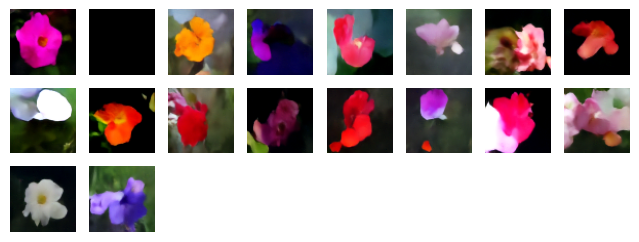

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1720 - n_loss: 0.1117
Epoch 164/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - i_loss: 0.1704 - n_loss: 0.1108

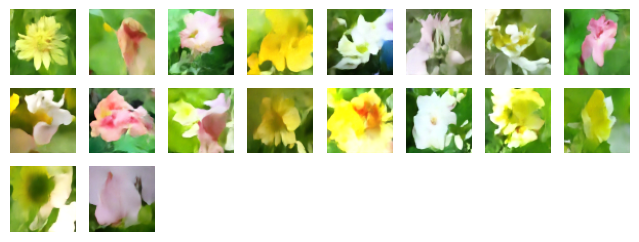

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 66ms/step - i_loss: 0.1704 - n_loss: 0.1108
Epoch 165/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1686 - n_loss: 0.1119

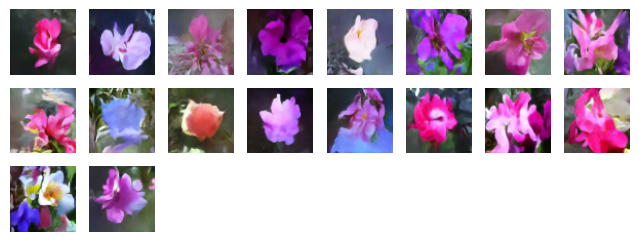

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1686 - n_loss: 0.1119
Epoch 166/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1715 - n_loss: 0.1110

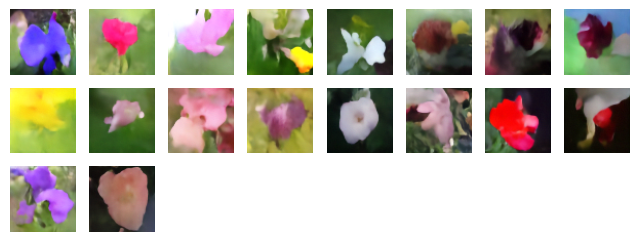

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1714 - n_loss: 0.1111
Epoch 167/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1695 - n_loss: 0.1100

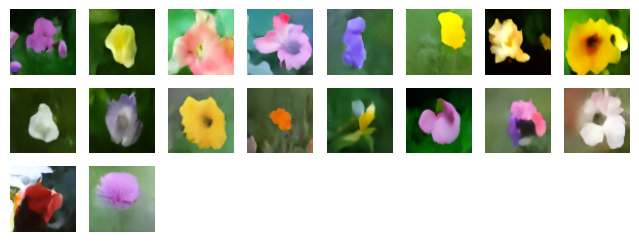

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1695 - n_loss: 0.1101
Epoch 168/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1706 - n_loss: 0.1116

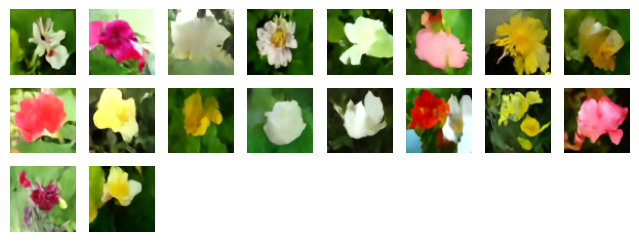

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1706 - n_loss: 0.1116
Epoch 169/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - i_loss: 0.1672 - n_loss: 0.1112

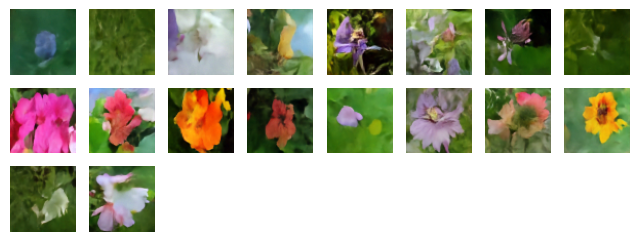

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 59ms/step - i_loss: 0.1672 - n_loss: 0.1112
Epoch 170/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1695 - n_loss: 0.1109

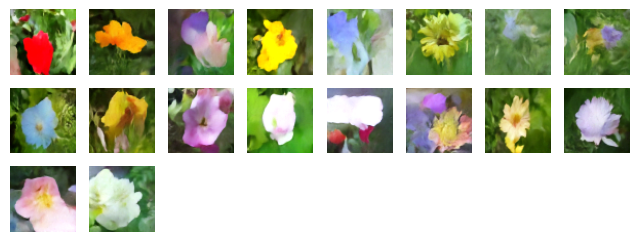

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1695 - n_loss: 0.1109
Epoch 171/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1699 - n_loss: 0.1108

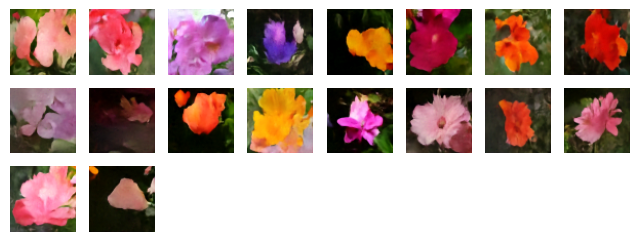

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1699 - n_loss: 0.1108
Epoch 172/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1678 - n_loss: 0.1122

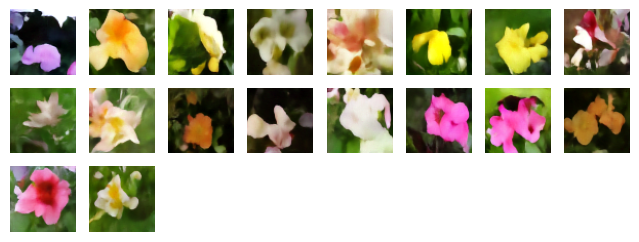

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1678 - n_loss: 0.1122
Epoch 173/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - i_loss: 0.1700 - n_loss: 0.1109

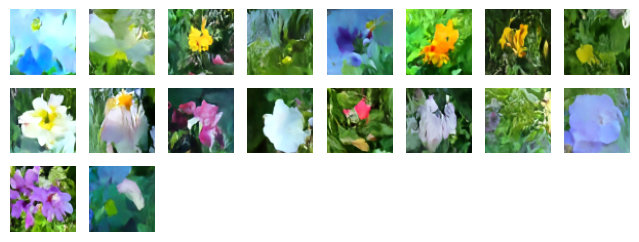

127/127 ━━━━━━━━━━━━━━━━━━━━ 10s 79ms/step - i_loss: 0.1700 - n_loss: 0.1109
Epoch 174/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - i_loss: 0.1683 - n_loss: 0.1114

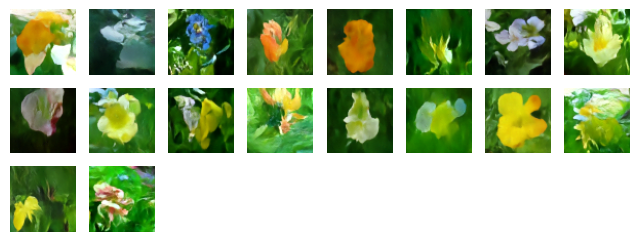

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 60ms/step - i_loss: 0.1683 - n_loss: 0.1114
Epoch 175/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1675 - n_loss: 0.1114

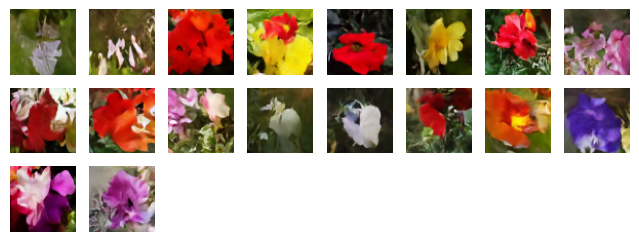

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1675 - n_loss: 0.1114
Epoch 176/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1680 - n_loss: 0.1125

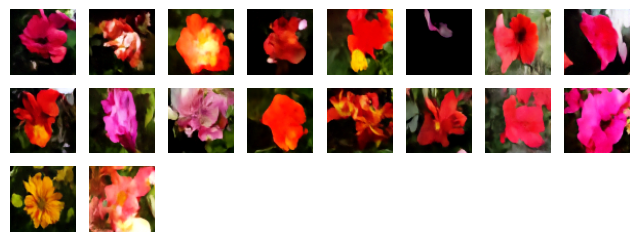

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1680 - n_loss: 0.1125
Epoch 177/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1693 - n_loss: 0.1107

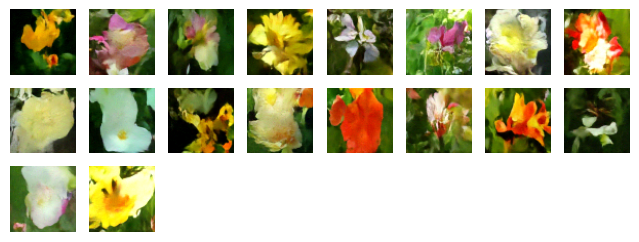

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1693 - n_loss: 0.1107
Epoch 178/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1703 - n_loss: 0.1117

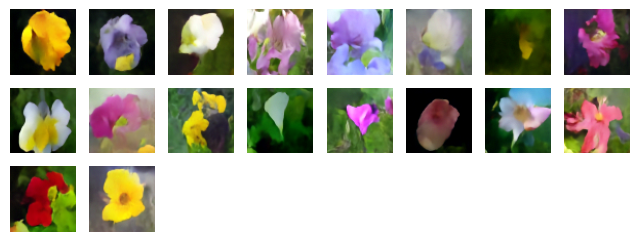

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1703 - n_loss: 0.1117
Epoch 179/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - i_loss: 0.1675 - n_loss: 0.1108

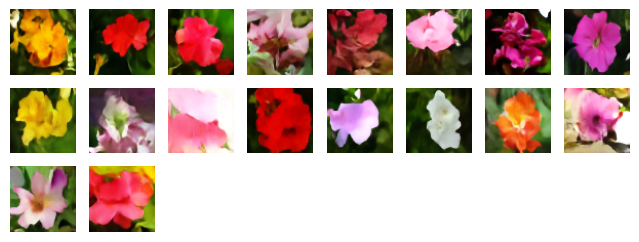

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 60ms/step - i_loss: 0.1675 - n_loss: 0.1108
Epoch 180/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1683 - n_loss: 0.1109

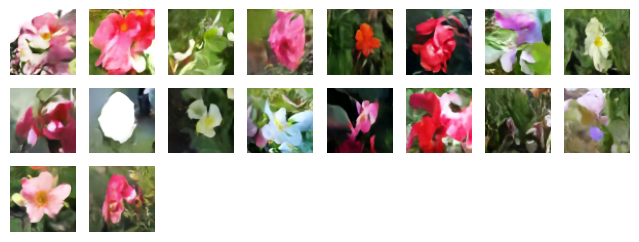

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1683 - n_loss: 0.1109
Epoch 181/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1663 - n_loss: 0.1116

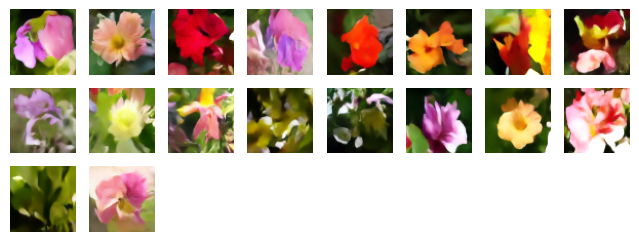

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1663 - n_loss: 0.1116
Epoch 182/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1676 - n_loss: 0.1122

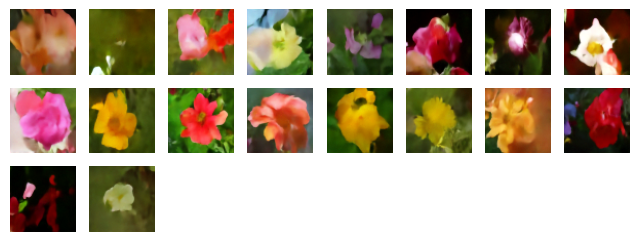

127/127 ━━━━━━━━━━━━━━━━━━━━ 10s 79ms/step - i_loss: 0.1676 - n_loss: 0.1122
Epoch 183/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1663 - n_loss: 0.1111

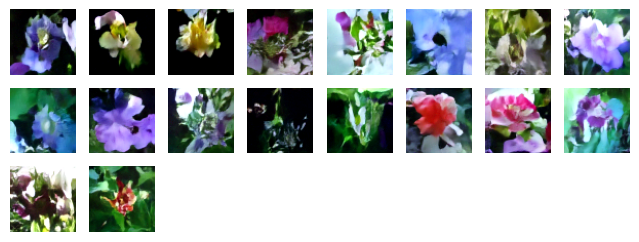

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 71ms/step - i_loss: 0.1664 - n_loss: 0.1111
Epoch 184/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - i_loss: 0.1679 - n_loss: 0.1123

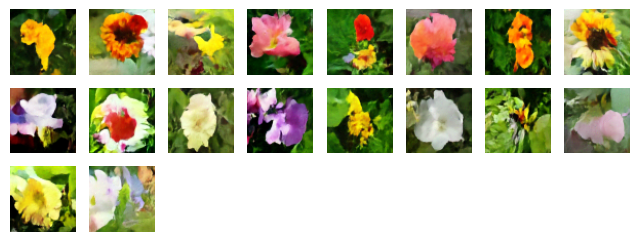

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 63ms/step - i_loss: 0.1679 - n_loss: 0.1123
Epoch 185/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1684 - n_loss: 0.1125

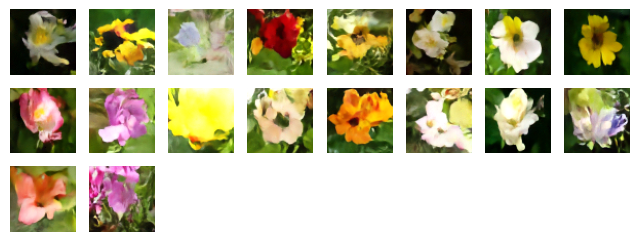

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1684 - n_loss: 0.1125
Epoch 186/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1678 - n_loss: 0.1125

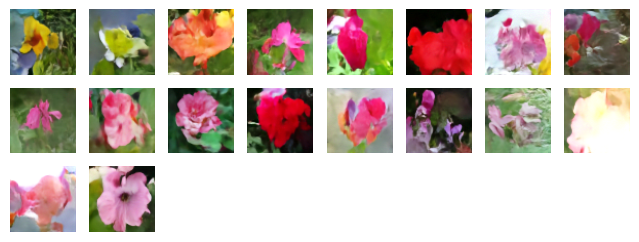

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1678 - n_loss: 0.1125
Epoch 187/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1673 - n_loss: 0.1112

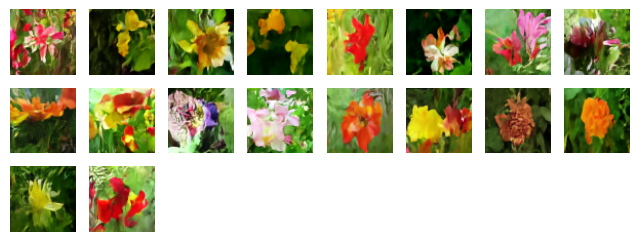

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1674 - n_loss: 0.1112
Epoch 188/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1709 - n_loss: 0.1095

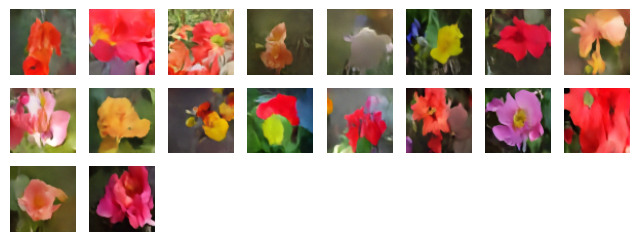

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1709 - n_loss: 0.1095
Epoch 189/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - i_loss: 0.1683 - n_loss: 0.1108

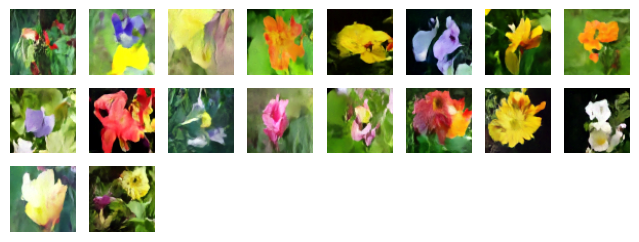

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 61ms/step - i_loss: 0.1683 - n_loss: 0.1108
Epoch 190/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1688 - n_loss: 0.1121

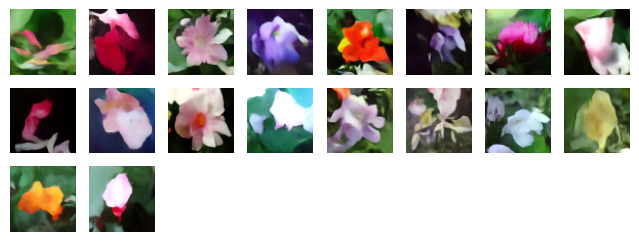

127/127 ━━━━━━━━━━━━━━━━━━━━ 10s 79ms/step - i_loss: 0.1688 - n_loss: 0.1121
Epoch 191/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1672 - n_loss: 0.1119

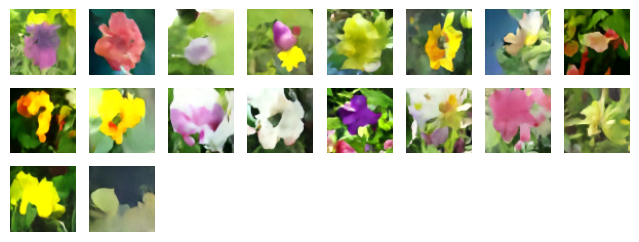

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1672 - n_loss: 0.1119
Epoch 192/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - i_loss: 0.1710 - n_loss: 0.1105

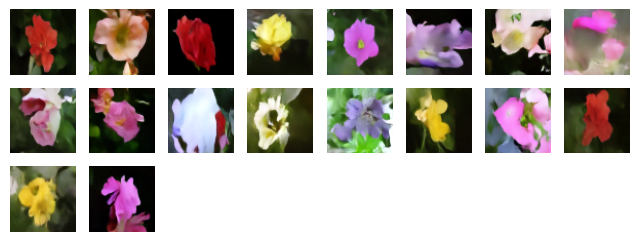

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1710 - n_loss: 0.1105
Epoch 193/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1709 - n_loss: 0.1101

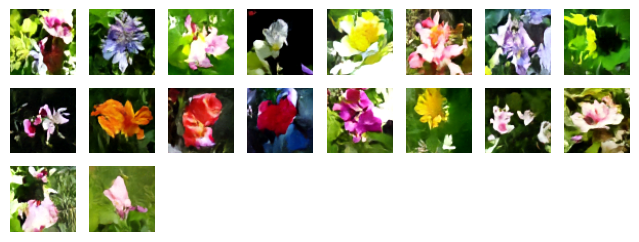

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 71ms/step - i_loss: 0.1709 - n_loss: 0.1101
Epoch 194/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - i_loss: 0.1703 - n_loss: 0.1096

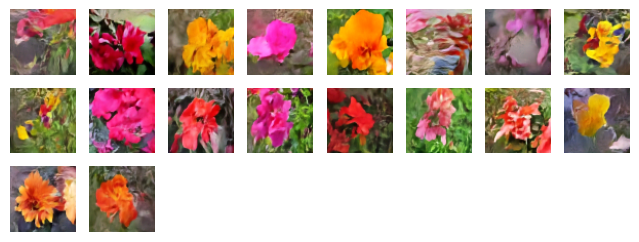

127/127 ━━━━━━━━━━━━━━━━━━━━ 8s 65ms/step - i_loss: 0.1703 - n_loss: 0.1096
Epoch 195/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1708 - n_loss: 0.1115

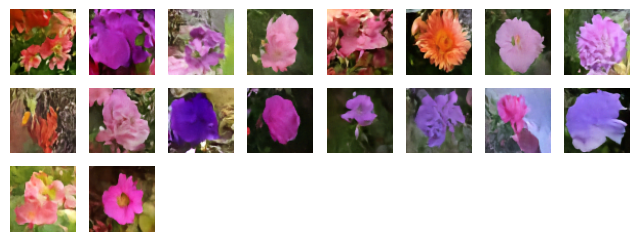

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1708 - n_loss: 0.1115
Epoch 196/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1673 - n_loss: 0.1121

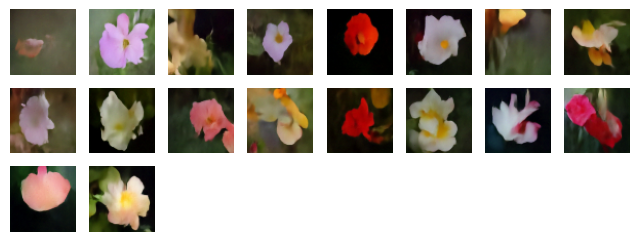

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1673 - n_loss: 0.1121
Epoch 197/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1678 - n_loss: 0.1126

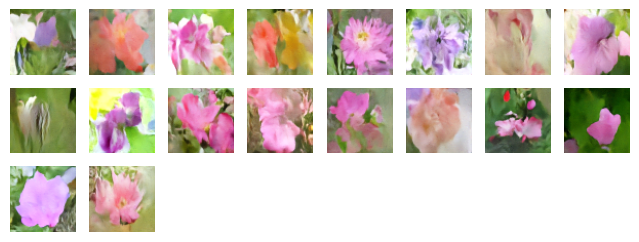

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1678 - n_loss: 0.1126
Epoch 198/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1690 - n_loss: 0.1111

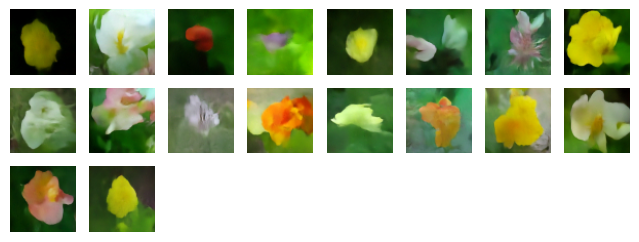

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 71ms/step - i_loss: 0.1690 - n_loss: 0.1111
Epoch 199/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - i_loss: 0.1698 - n_loss: 0.1091

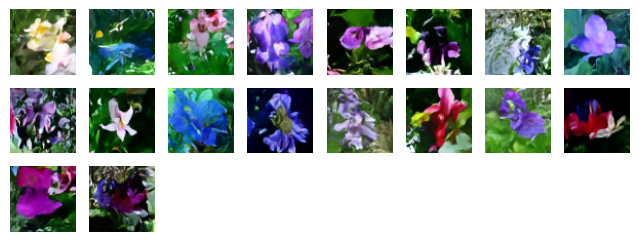

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1698 - n_loss: 0.1091
Epoch 200/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1740 - n_loss: 0.1088

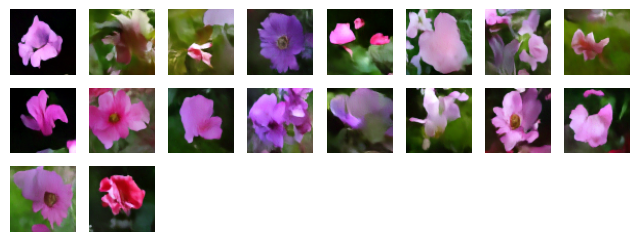

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1740 - n_loss: 0.1088
Epoch 201/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - i_loss: 0.1716 - n_loss: 0.1096

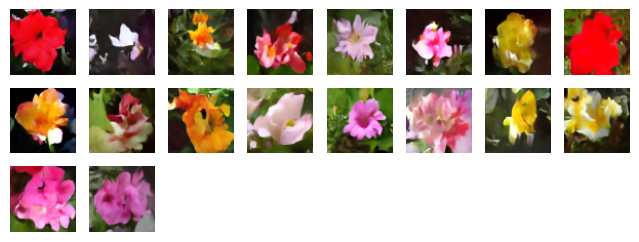

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1716 - n_loss: 0.1096
Epoch 202/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1683 - n_loss: 0.1115

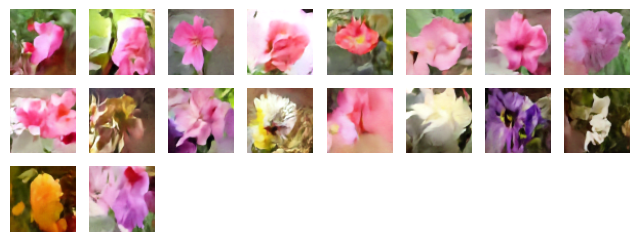

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1683 - n_loss: 0.1115
Epoch 203/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1667 - n_loss: 0.1115

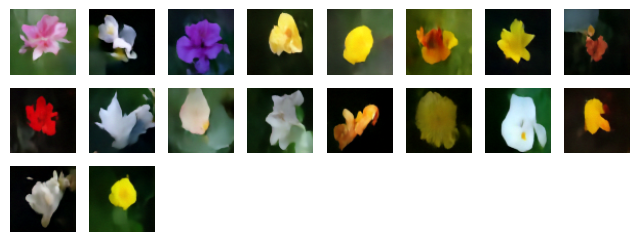

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 70ms/step - i_loss: 0.1668 - n_loss: 0.1115
Epoch 204/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step - i_loss: 0.1683 - n_loss: 0.1103

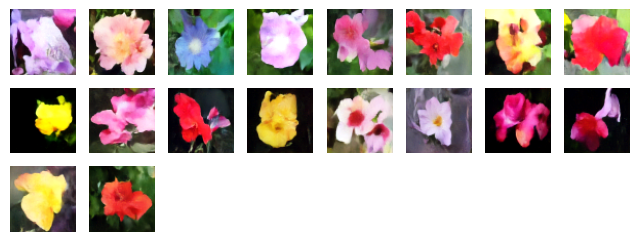

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 69ms/step - i_loss: 0.1683 - n_loss: 0.1103
Epoch 205/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1707 - n_loss: 0.1090

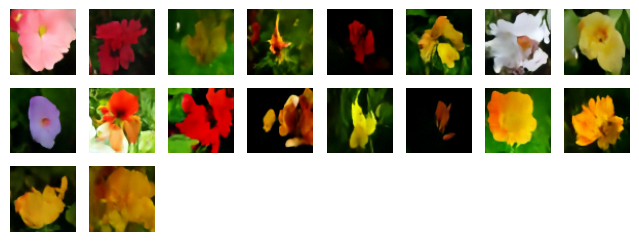

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1707 - n_loss: 0.1090
Epoch 206/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1722 - n_loss: 0.1093

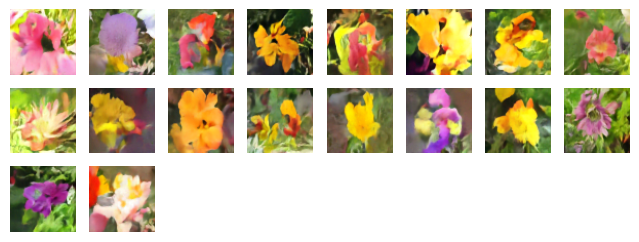

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1722 - n_loss: 0.1093
Epoch 207/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1679 - n_loss: 0.1115

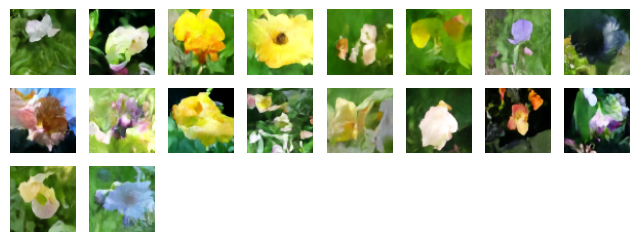

127/127 ━━━━━━━━━━━━━━━━━━━━ 10s 78ms/step - i_loss: 0.1679 - n_loss: 0.1115
Epoch 208/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1672 - n_loss: 0.1113

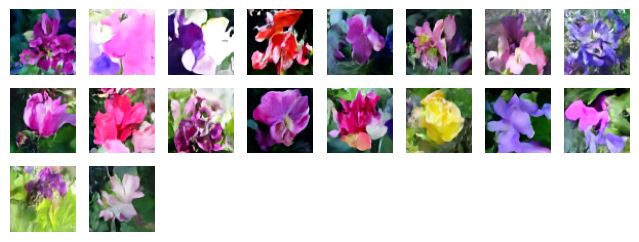

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 69ms/step - i_loss: 0.1672 - n_loss: 0.1113
Epoch 209/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1684 - n_loss: 0.1115

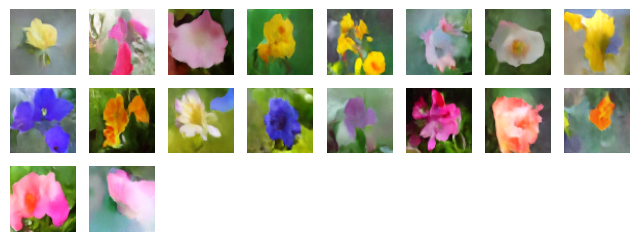

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1683 - n_loss: 0.1115
Epoch 210/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1680 - n_loss: 0.1104

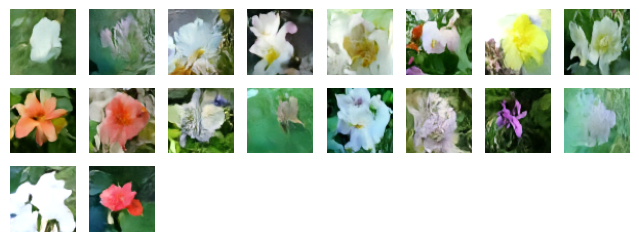

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - i_loss: 0.1680 - n_loss: 0.1104
Epoch 211/500
126/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1697 - n_loss: 0.1103

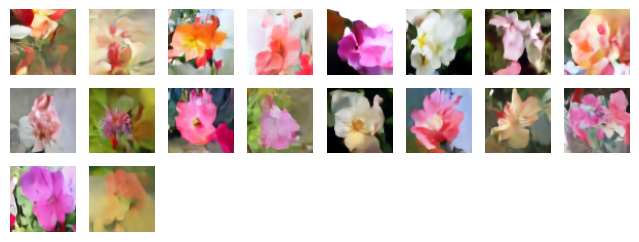

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1697 - n_loss: 0.1103
Epoch 212/500
127/127 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - i_loss: 0.1710 - n_loss: 0.1105

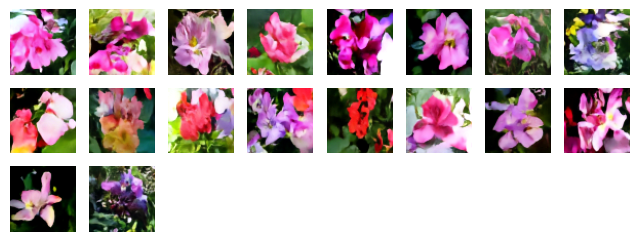

127/127 ━━━━━━━━━━━━━━━━━━━━ 9s 72ms/step - i_loss: 0.1709 - n_loss: 0.1105
Epoch 213/500
 39/127 ━━━━━━━━━━━━━━━━━━━━ 4s 50ms/step - i_loss: 0.1671 - n_loss: 0.1123

In [23]:
data, dateLen = get_dataset("oxford_flowers102", batch_size=batch_size, image_scale=image_size)

STEPS = dateLen // batch_size

# run training and plot generated images periodically
model.fit(
    data,
    epochs=500,steps_per_epoch=STEPS,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

## Inference

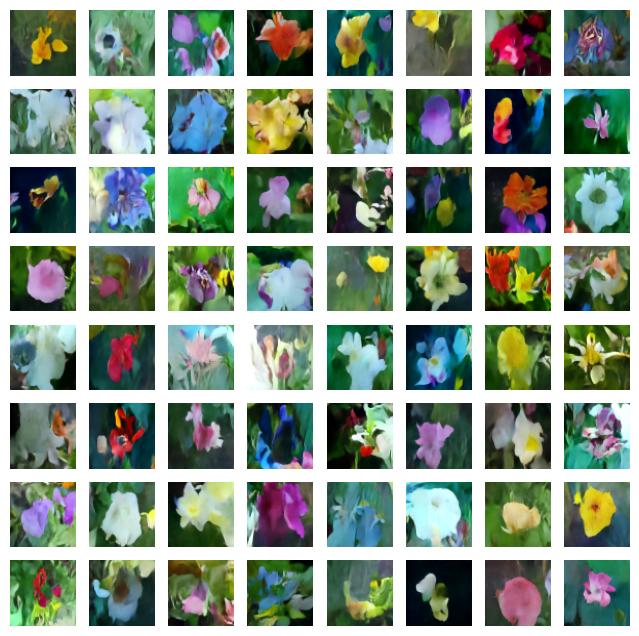

In [ ]:
# load the best model and generate images
# model.load_weights(checkpoint_path)
imgs = model.generate(num_images=64, diffusion_steps=100)
plotImages(imgs)

## Results

By running the training for at least 50 epochs (takes 2 hours on a T4 GPU and 30 minutes
on an A100 GPU), one can get high quality image generations using this code example.

The evolution of a batch of images over a 80 epoch training (color artifacts are due to
GIF compression):

![flowers training gif](https://i.imgur.com/FSCKtZq.gif)

Images generated using between 1 and 20 sampling steps from the same initial noise:

![flowers sampling steps gif](https://i.imgur.com/tM5LyH3.gif)

Interpolation (spherical) between initial noise samples:

![flowers interpolation gif](https://i.imgur.com/hk5Hd5o.gif)

Deterministic sampling process (noisy images on top, predicted images on bottom, 40
steps):

![flowers deterministic generation gif](https://i.imgur.com/wCvzynh.gif)

Stochastic sampling process (noisy images on top, predicted images on bottom, 80 steps):

![flowers stochastic generation gif](https://i.imgur.com/kRXOGzd.gif)

## Lessons learned

During preparation for this code example I have run numerous experiments using
[this repository](https://github.com/beresandras/clear-diffusion-keras).
In this section I list
the lessons learned and my recommendations in my subjective order of importance.

### Algorithmic tips

* **min. and max. signal rates**: I found the min. signal rate to be an important
hyperparameter. Setting it too low will make the generated images oversaturated, while
setting it too high will make them undersaturated. I recommend tuning it carefully. Also,
setting it to 0 will lead to a division by zero error. The max. signal rate can be set to
1, but I found that setting it lower slightly improves generation quality.
* **loss function**: While large models tend to use mean squared error (MSE) loss, I
recommend using mean absolute error (MAE) on this dataset. In my experience MSE loss
generates more diverse samples (it also seems to hallucinate more
[Section 3](https://arxiv.org/abs/2111.05826)), while MAE loss leads to smoother images.
I recommend trying both.
* **weight decay**: I did occasionally run into diverged trainings when scaling up the
model, and found that weight decay helps in avoiding instabilities at a low performance
cost. This is why I use
[AdamW](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/experimental/AdamW)
instead of [Adam](https://keras.io/api/optimizers/adam/) in this example.
* **exponential moving average of weights**: This helps to reduce the variance of the KID
metric, and helps in averaging out short-term changes during training.
* **image augmentations**: Though I did not use image augmentations in this example, in
my experience adding horizontal flips to the training increases generation performance,
while random crops do not. Since we use a supervised denoising loss, overfitting can be
an issue, so image augmentations might be important on small datasets. One should also be
careful not to use
[leaky augmentations](https://keras.io/examples/generative/gan_ada/#invertible-data-augmentation),
which can be done following
[this method (end of Section 5)](https://arxiv.org/abs/2206.00364) for instance.
* **data normalization**: In the literature the pixel values of images are usually
converted to the -1 to 1 range. For theoretical correctness, I normalize the images to
have zero mean and unit variance instead, exactly like the random noises.
* **noise level input**: I chose to input the noise variance to the network, as it is
symmetrical under our sampling schedule. One could also input the noise rate (similar
performance), the signal rate (lower performance), or even the
[log-signal-to-noise ratio (Appendix B.1)](https://arxiv.org/abs/2107.00630)
(did not try, as its range is highly
dependent on the min. and max. signal rates, and would require adjusting the min.
embedding frequency accordingly).
* **gradient clipping**: Using global gradient clipping with a value of 1 can help with
training stability for large models, but decreased performance significantly in my
experience.
* **residual connection downscaling**: For
[deeper models (Appendix B)](https://arxiv.org/abs/2205.11487), scaling the residual
connections with 1/sqrt(2) can be helpful, but did not help in my case.
* **learning rate**: For me, [Adam optimizer's](https://keras.io/api/optimizers/adam/)
default learning rate of 1e-3 worked very well, but lower learning rates are more common
in the [literature (Tables 11-13)](https://arxiv.org/abs/2105.05233).

### Architectural tips

* **sinusoidal embedding**: Using sinusoidal embeddings on the noise level input of the
network is crucial for good performance. I recommend setting the min. embedding frequency
to the reciprocal of the range of this input, and since we use the noise variance in this
example, it can be left always at 1. The max. embedding frequency controls the smallest
change in the noise variance that the network will be sensitive to, and the embedding
dimensions set the number of frequency components in the embedding. In my experience the
performance is not too sensitive to these values.
* **skip connections**: Using skip connections in the network architecture is absolutely
critical, without them the model will fail to learn to denoise at a good performance.
* **residual connections**: In my experience residual connections also significantly
improve performance, but this might be due to the fact that we only input the noise
level embeddings to the first layer of the network instead of to all of them.
* **normalization**: When scaling up the model, I did occasionally encounter diverged
trainings, using normalization layers helped to mitigate this issue. In the literature it
is common to use
[GroupNormalization](https://www.tensorflow.org/addons/api_docs/python/tfa/layers/GroupNormalization)
(with 8 groups for example) or
[LayerNormalization](https://keras.io/api/layers/normalization_layers/layer_normalization/)
in the network, I however chose to use
[BatchNormalization](https://keras.io/api/layers/normalization_layers/batch_normalization/),
as it gave similar benefits in my experiments but was computationally lighter.
* **activations**: The choice of activation functions had a larger effect on generation
quality than I expected. In my experiments using non-monotonic activation functions
outperformed monotonic ones (such as
[ReLU](https://www.tensorflow.org/api_docs/python/tf/keras/activations/relu)), with
[Swish](https://www.tensorflow.org/api_docs/python/tf/keras/activations/swish) performing
the best (this is also what [Imagen uses, page 41](https://arxiv.org/abs/2205.11487)).
* **attention**: As mentioned earlier, it is common in the literature to use
[attention layers](https://keras.io/api/layers/attention_layers/multi_head_attention/) at low
resolutions for better global coherence. I omitted them for simplicity.
* **upsampling**:
[Bilinear and nearest neighbour upsampling](https://keras.io/api/layers/reshaping_layers/up_sampling2d/)
in the network performed similarly, however I did not try
[transposed convolutions](https://keras.io/api/layers/convolution_layers/convolution2d_transpose/).

For a similar list about GANs check out
[this Keras tutorial](https://keras.io/examples/generative/gan_ada/#gan-tips-and-tricks).

## What to try next?

If you would like to dive in deeper to the topic, I recommend checking out
[this repository](https://github.com/beresandras/clear-diffusion-keras) that I created in
preparation for this code example, which implements a wider range of features in a
similar style, such as:

* stochastic sampling
* second-order sampling based on the
[differential equation view of DDIMs (Equation 13)](https://arxiv.org/abs/2010.02502)
* more diffusion schedules
* more network output types: predicting image or
[velocity (Appendix D)](https://arxiv.org/abs/2202.00512) instead of noise
* more datasets

## Related works

* [Score-based generative modeling](https://yang-song.github.io/blog/2021/score/)
(blogpost)
* [What are diffusion models?](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/)
(blogpost)
* [Annotated diffusion model](https://huggingface.co/blog/annotated-diffusion) (blogpost)
* [CVPR 2022 tutorial on diffusion models](https://cvpr2022-tutorial-diffusion-models.github.io/)
(slides available)
* [Elucidating the Design Space of Diffusion-Based Generative Models](https://arxiv.org/abs/2206.00364):
attempts unifying diffusion methods under a common framework
* High-level video overviews: [1](https://www.youtube.com/watch?v=yTAMrHVG1ew),
[2](https://www.youtube.com/watch?v=344w5h24-h8)
* Detailed technical videos: [1](https://www.youtube.com/watch?v=fbLgFrlTnGU),
[2](https://www.youtube.com/watch?v=W-O7AZNzbzQ)
* Score-based generative models: [NCSN](https://arxiv.org/abs/1907.05600),
[NCSN+](https://arxiv.org/abs/2006.09011), [NCSN++](https://arxiv.org/abs/2011.13456)
* Denoising diffusion models: [DDPM](https://arxiv.org/abs/2006.11239),
[DDIM](https://arxiv.org/abs/2010.02502), [DDPM+](https://arxiv.org/abs/2102.09672),
[DDPM++](https://arxiv.org/abs/2105.05233)
* Large diffusion models: [GLIDE](https://arxiv.org/abs/2112.10741),
[DALL-E 2](https://arxiv.org/abs/2204.06125/), [Imagen](https://arxiv.org/abs/2205.11487)
